In [1]:
#Load background software

import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import matplotlib
#import mnnpy
import scrublet as scr
import anndata
#import csv
#import seaborn as sns

#Set scanpy settings for visualizations
sc.settings.verbosity = 2 #Scanpy verbosity reporting
sc.settings.set_figure_params(dpi=100) #Figure pixel resolution settings

In [2]:
import warnings
warnings.filterwarnings("ignore")


In [810]:
#Upload stage specific read data
corr_data = sc.read_h5ad("C:/Users/coron/OneDrive/Desktop/snRNAseq/St13/X__tropicalis_st13_NUCLEI/DGE_unfiltered/PARSE-Unfiltered_St13_Compatible.h5ad")

### Leiden clustering ###

In [66]:
sc.tl.leiden(corr_data, key_added = "leiden_1.0") # default resolution in 1.0
sc.tl.leiden(corr_data, resolution = 0.3, key_added = "leiden_0.3")
sc.tl.leiden(corr_data, resolution = 0.4, key_added = "leiden_0.4")
sc.tl.leiden(corr_data, resolution = 0.2, key_added = "leiden_0.2")
sc.tl.leiden(corr_data, resolution = 1.2, key_added = "leiden_1.2")
sc.tl.leiden(corr_data, resolution = 1.4, key_added = "leiden_1.4")

running Leiden clustering
    finished (0:00:01)
running Leiden clustering
    finished (0:00:01)
running Leiden clustering
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)
running Leiden clustering
    finished (0:00:01)
running Leiden clustering
    finished (0:00:00)


### Inner Ectoderm ###

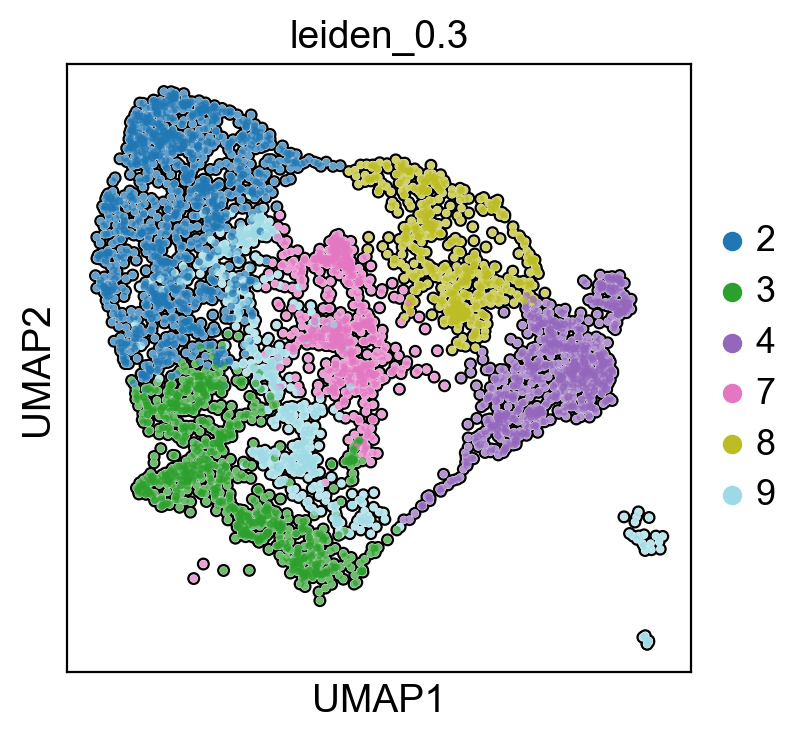

In [76]:
# Define the cluster labels you want to keep
selected_clusters = ['3', '7', '2', '8', '9', '4']

# Subset the AnnData object based on the leiden_0.1 column
innerecto_subset = corr_data[corr_data.obs['leiden_0.3'].isin(selected_clusters)].copy()
sc.pl.umap(innerecto_subset, color = "leiden_0.3", add_outline=True, palette="tab20")

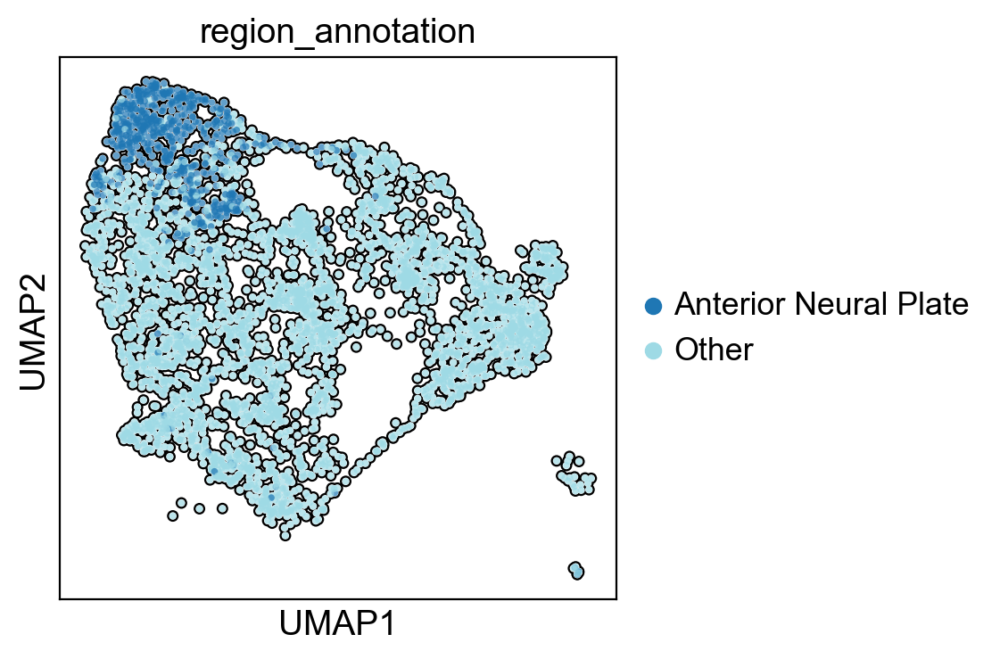

In [159]:
# Define a threshold for "high" expression
threshold = 1  # adjust based on your data (you might use 0.5, 1, or a quantile)

# Logical mask: cells where both rax and pax6 are highly expressed
mask = (innerecto_subset[:, 'rax'].X > threshold).toarray().flatten() & \
       (innerecto_subset[:, 'pax6'].X > threshold).toarray().flatten()

# Create a new column for annotation if it doesn't exist
innerecto_subset.obs['region_annotation'] = 'Other'

# Assign "Anterior Neural Plate" to cells meeting the condition
innerecto_subset.obs.loc[mask, 'region_annotation'] = 'Anterior Neural Plate'
sc.pl.umap(innerecto_subset, color = "region_annotation", add_outline=True, palette="tab20")

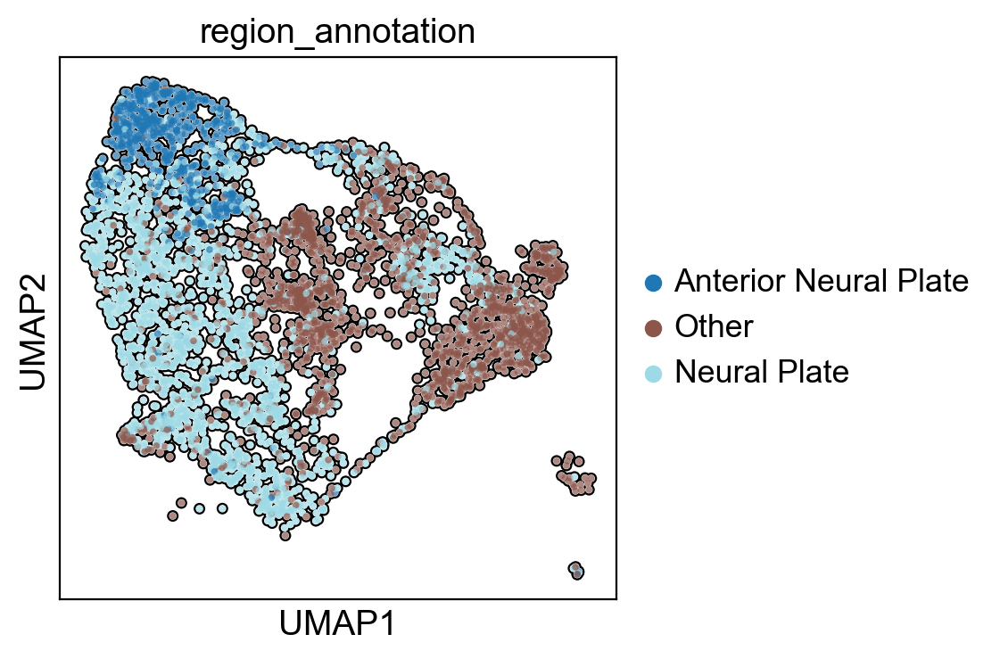

In [160]:
# Define expression threshold
threshold = 1  # Adjust this as needed

# Add the new category before assigning it
innerecto_subset.obs['region_annotation'] = innerecto_subset.obs['region_annotation'].cat.add_categories(['Neural Plate'])

# Now assign the new label
innerecto_subset.obs.loc[mask_to_update, 'region_annotation'] = 'Neural Plate'


sox_mask = (
    (innerecto_subset[:, 'sox2'].X > threshold).toarray().flatten() |
    (innerecto_subset[:, 'sox3'].X > threshold).toarray().flatten()
)

# Only apply the new label to cells that are still labeled "Other"
mask_to_update = (innerecto_subset.obs['region_annotation'] == 'Other') & sox_mask

# Assign new label
innerecto_subset.obs.loc[mask_to_update, 'region_annotation'] = 'Neural Plate'
sc.pl.umap(innerecto_subset, color = "region_annotation", add_outline=True, palette="tab20")

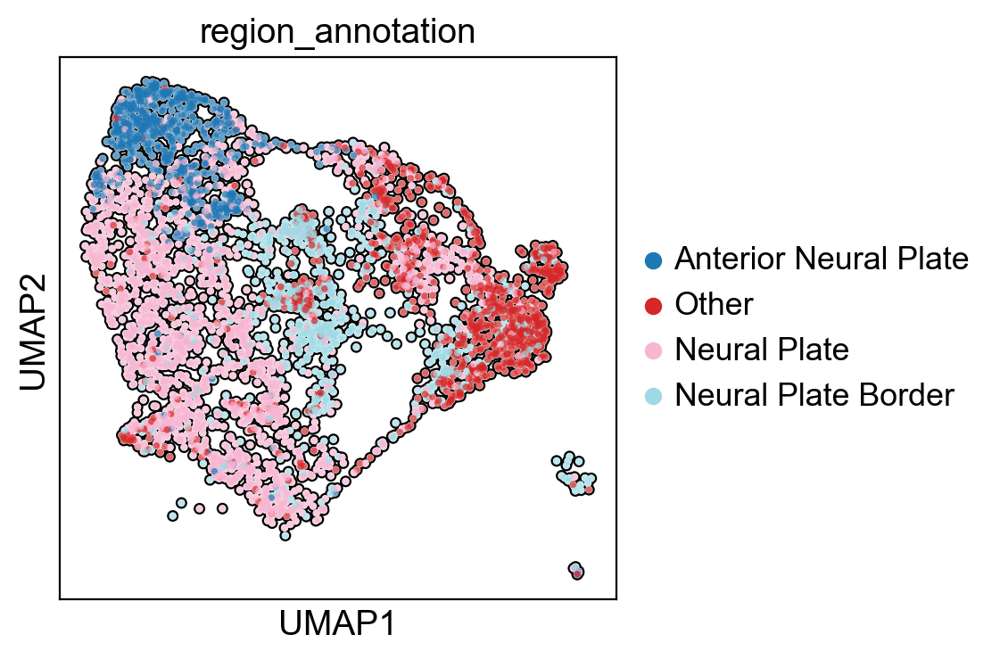

In [161]:
# Define expression threshold for pax3
threshold = 1  # Adjust if needed

# Add new category for the label
innerecto_subset.obs['region_annotation'] = innerecto_subset.obs['region_annotation'].cat.add_categories(['Neural Plate Border'])

# Mask for high pax3 expression
pax3_mask = (innerecto_subset[:, 'pax3'].X > threshold).toarray().flatten()

# Only apply new label to cells not already labeled as Neural Plate or Anterior Neural Plate
mask_to_update = pax3_mask & ~innerecto_subset.obs['region_annotation'].isin(['Neural Plate', 'Anterior Neural Plate'])

# Assign new label
innerecto_subset.obs.loc[mask_to_update, 'region_annotation'] = 'Neural Plate Border'

# Visualize the updated annotations
sc.pl.umap(innerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


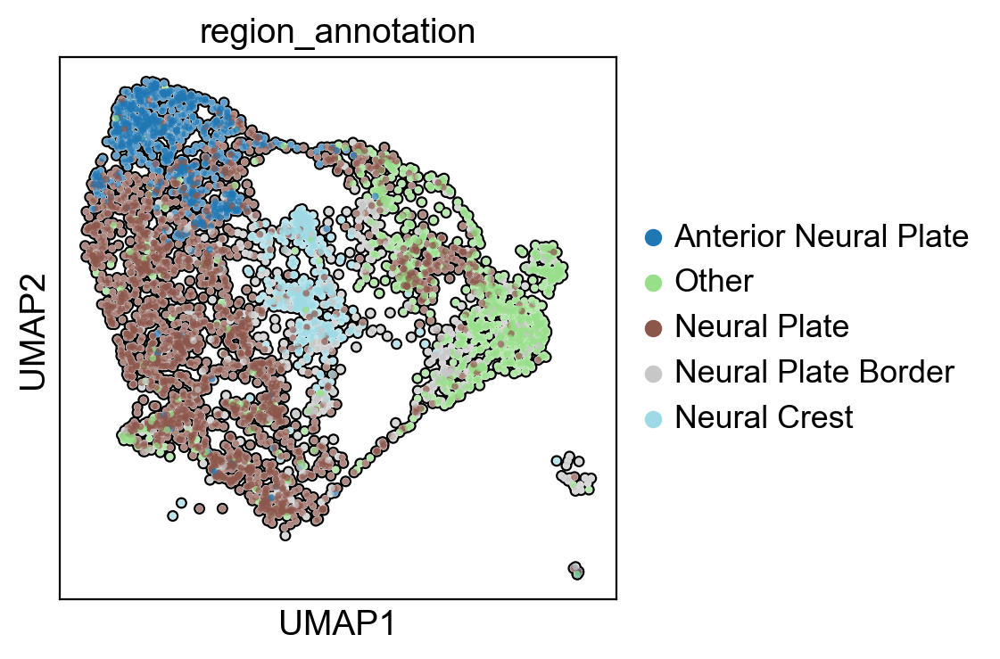

In [162]:
# Define expression threshold
threshold = 0.5  # Adjust if needed

# Add the new category
innerecto_subset.obs['region_annotation'] = innerecto_subset.obs['region_annotation'].cat.add_categories(['Neural Crest'])

# Create mask for high snai2 and sox9 expression
snai2_mask = (innerecto_subset[:, 'snai2'].X > threshold).toarray().flatten()
sox9_mask = (innerecto_subset[:, 'sox9'].X > threshold).toarray().flatten()
expression_mask = snai2_mask & sox9_mask

# Exclude only Neural Plate and Anterior Neural Plate from being overwritten
mask_to_update = expression_mask & ~innerecto_subset.obs['region_annotation'].isin(['Neural Plate', 'Anterior Neural Plate'])

# Apply new label
innerecto_subset.obs.loc[mask_to_update, 'region_annotation'] = 'Neural Crest'

# Visualize the updated annotations
sc.pl.umap(innerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


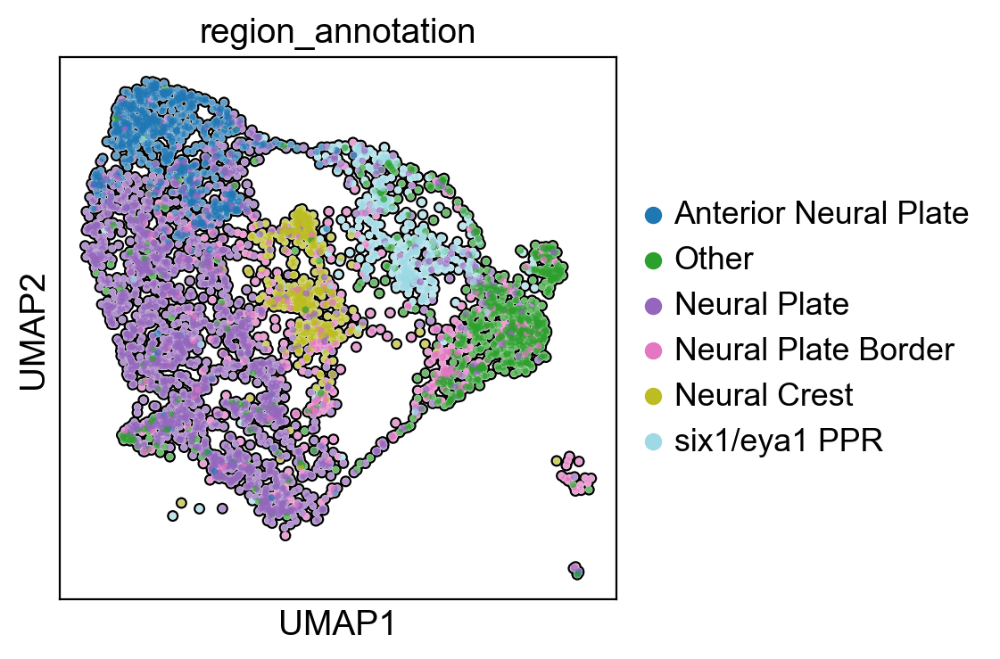

In [163]:
# Define expression threshold
threshold = 0.5  # Adjust if needed

# Add the new category
innerecto_subset.obs['region_annotation'] = innerecto_subset.obs['region_annotation'].cat.add_categories(['six1/eya1 PPR'])

# Create mask for high snai2 and sox9 expression
eya1_mask = (innerecto_subset[:, 'eya1'].X > threshold).toarray().flatten()
six1_mask = (innerecto_subset[:, 'six1'].X > threshold).toarray().flatten()
expression_mask = eya1_mask & six1_mask

# Exclude only Neural Plate and Anterior Neural Plate from being overwritten
mask_to_update = expression_mask & ~innerecto_subset.obs['region_annotation'].isin([])

# Apply new label
innerecto_subset.obs.loc[mask_to_update, 'region_annotation'] = 'six1/eya1 PPR'

# Visualize the updated annotations
sc.pl.umap(innerecto_subset, color='region_annotation', add_outline=True, palette="tab20", color_map=plt.cm.turbo)


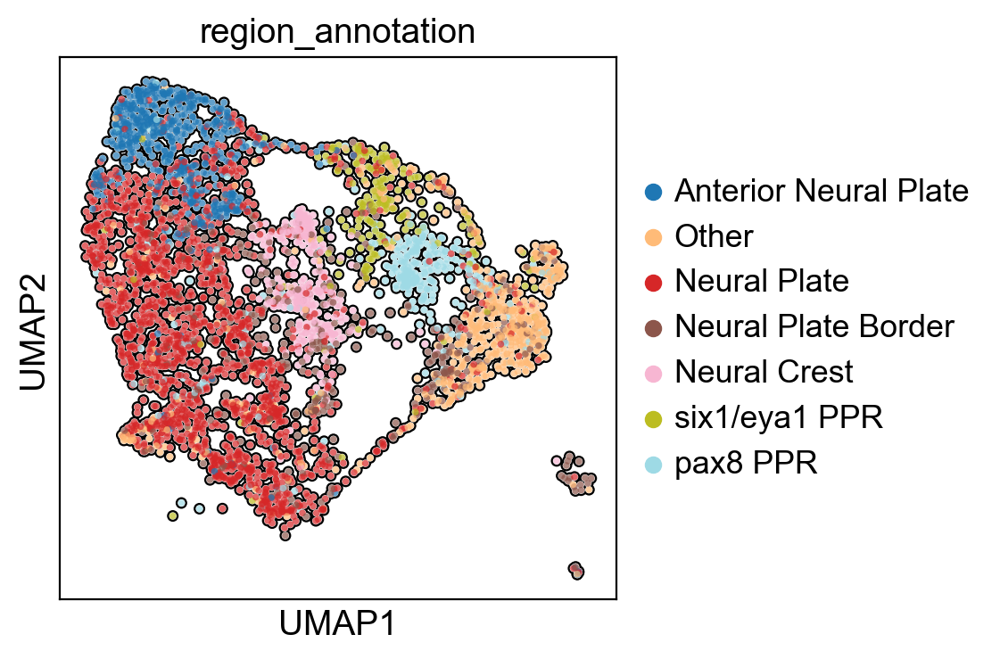

In [164]:
# Define expression threshold
threshold = 0.5  # Adjust if needed

# Add the new category
innerecto_subset.obs['region_annotation'] = innerecto_subset.obs['region_annotation'].cat.add_categories(['pax8 PPR'])

# Create mask for high snai2 and sox9 expression
pax8_mask = (innerecto_subset[:, 'pax8'].X > threshold).toarray().flatten()
expression_mask = pax8_mask 

# Exclude only Neural Plate and Anterior Neural Plate from being overwritten
mask_to_update = expression_mask & ~innerecto_subset.obs['region_annotation'].isin([])

# Apply new label
innerecto_subset.obs.loc[mask_to_update, 'region_annotation'] = 'pax8 PPR'

# Visualize the updated annotations
sc.pl.umap(innerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


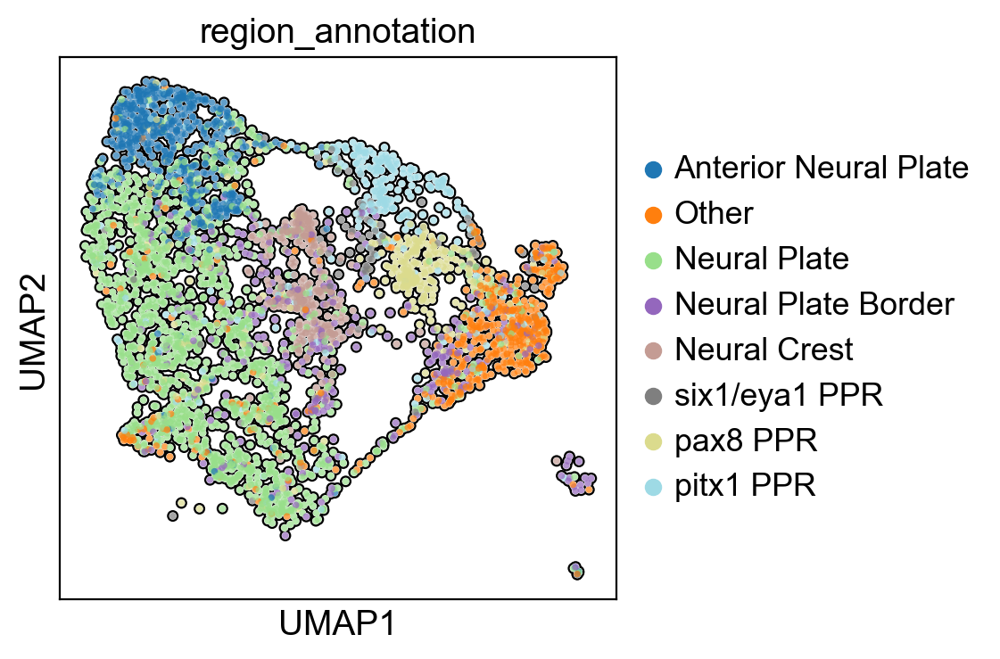

In [165]:
# Define expression threshold
threshold = 0.5  # Adjust if needed

# Add the new category
innerecto_subset.obs['region_annotation'] = innerecto_subset.obs['region_annotation'].cat.add_categories(['pitx1 PPR'])

# Create mask for high snai2 and sox9 expression
pitx1_mask = (innerecto_subset[:, 'pitx1'].X > threshold).toarray().flatten()
expression_mask = pitx1_mask 

# Exclude only Neural Plate and Anterior Neural Plate from being overwritten
mask_to_update = expression_mask & ~innerecto_subset.obs['region_annotation'].isin([])

# Apply new label
innerecto_subset.obs.loc[mask_to_update, 'region_annotation'] = 'pitx1 PPR'

# Visualize the updated annotations
sc.pl.umap(innerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


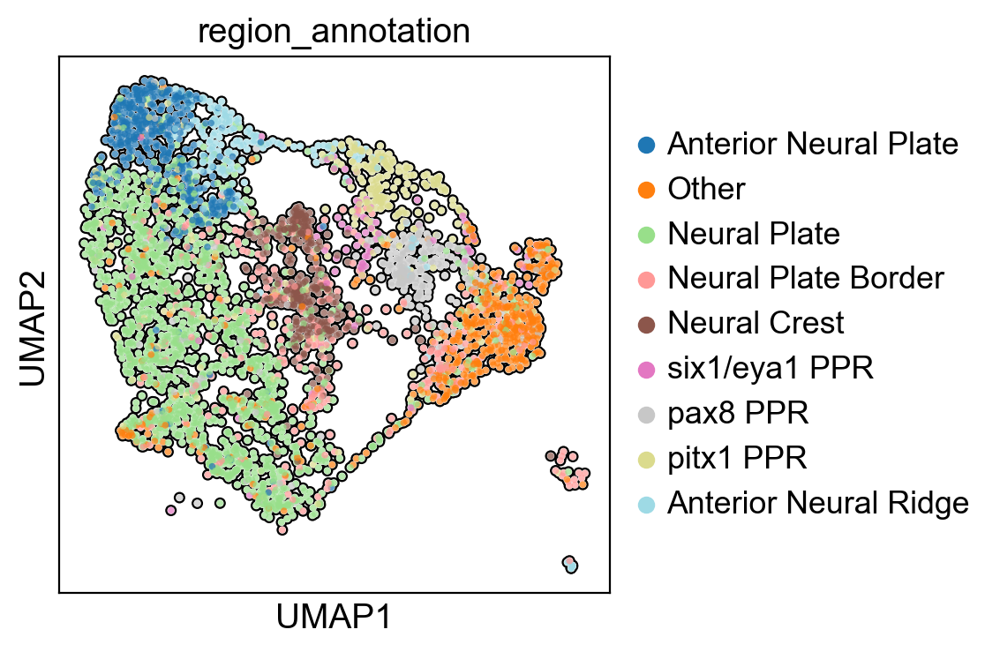

In [166]:
# Define expression threshold
threshold = 0.5  # Adjust if needed

# Add the new category
innerecto_subset.obs['region_annotation'] = innerecto_subset.obs['region_annotation'].cat.add_categories(['Anterior Neural Ridge'])

# Create mask for high emx1l and foxg1 expression
anr_mask = (
    (innerecto_subset[:, 'emx1l'].X > threshold).toarray().flatten() &
    (innerecto_subset[:, 'foxg1'].X > threshold).toarray().flatten()
)

# Apply new label regardless of existing annotation
innerecto_subset.obs.loc[anr_mask, 'region_annotation'] = 'Anterior Neural Ridge'

# Visualize the updated annotations
sc.pl.umap(innerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


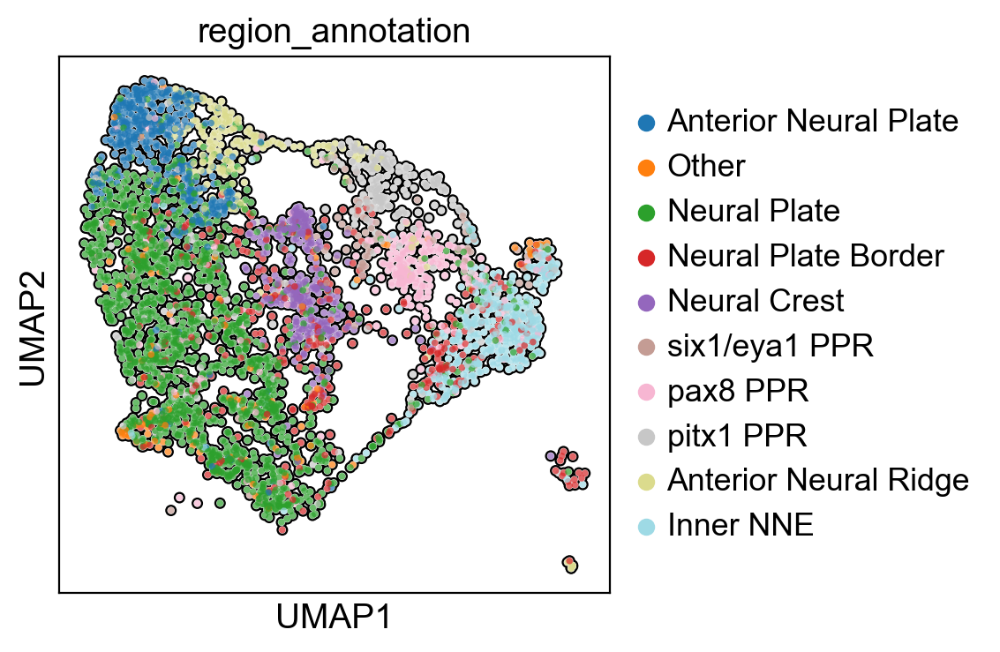

In [167]:
# Define expression threshold
threshold = 0.5  # Adjust if needed

# Add the new category
innerecto_subset.obs['region_annotation'] = innerecto_subset.obs['region_annotation'].cat.add_categories(['Inner NNE Prog.'])

# Create mask for high tp63 expression
tp63_mask = (innerecto_subset[:, 'tp63'].X > threshold).toarray().flatten()

# Only overwrite cells currently labeled "Other"
mask_to_update = (innerecto_subset.obs['region_annotation'] == 'Other') & tp63_mask

# Apply the new label
innerecto_subset.obs.loc[mask_to_update, 'region_annotation'] = 'Inner NNE Prog.'

# Visualize the result
sc.pl.umap(innerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


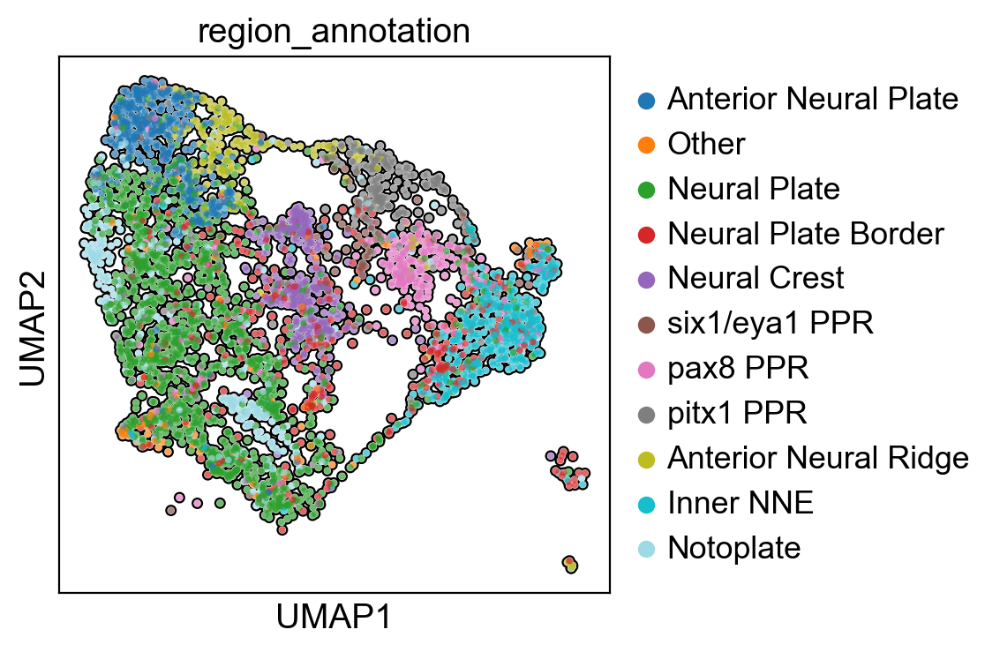

In [168]:
# Define expression threshold
threshold = 0.5  # Adjust if needed

# Add the new category
innerecto_subset.obs['region_annotation'] = innerecto_subset.obs['region_annotation'].cat.add_categories(['Notoplate'])

# Create mask for high shh and ptch2 expression
shh_mask = (innerecto_subset[:, 'shh'].X > threshold).toarray().flatten()
ptch2_mask = (innerecto_subset[:, 'ptch2'].X > threshold).toarray().flatten()

# Combine the masks for both shh and ptch2 expression (OR condition)
expression_mask = shh_mask & ptch2_mask

# Apply the new label, overwrite any current labels
innerecto_subset.obs.loc[expression_mask, 'region_annotation'] = 'Notoplate'

# Visualize the result
sc.pl.umap(innerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


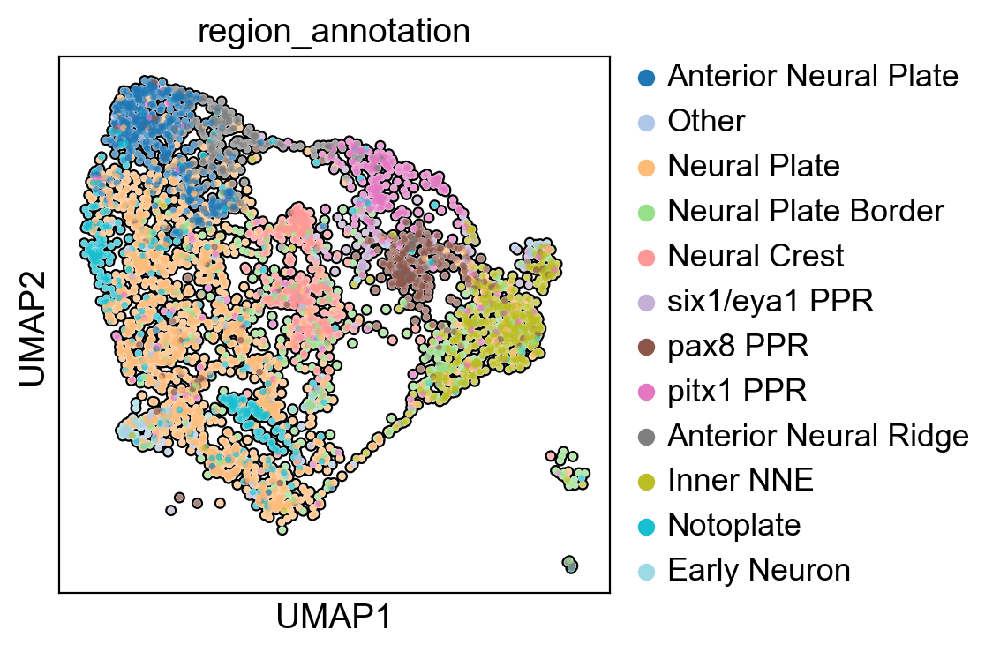

In [169]:
# Define expression threshold for ebf2
threshold_ebf2 = 2.5  # Adjust if needed

# Add the new category for Early Neuron
innerecto_subset.obs['region_annotation'] = innerecto_subset.obs['region_annotation'].cat.add_categories(['Early Neuron'])

# Create mask for high ebf2 expression
ebf2_mask = (innerecto_subset[:, 'ebf2'].X > threshold_ebf2).toarray().flatten()

# Apply the new label, overwrite any current labels
innerecto_subset.obs.loc[ebf2_mask, 'region_annotation'] = 'Early Neuron'

# Visualize the result
sc.pl.umap(innerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


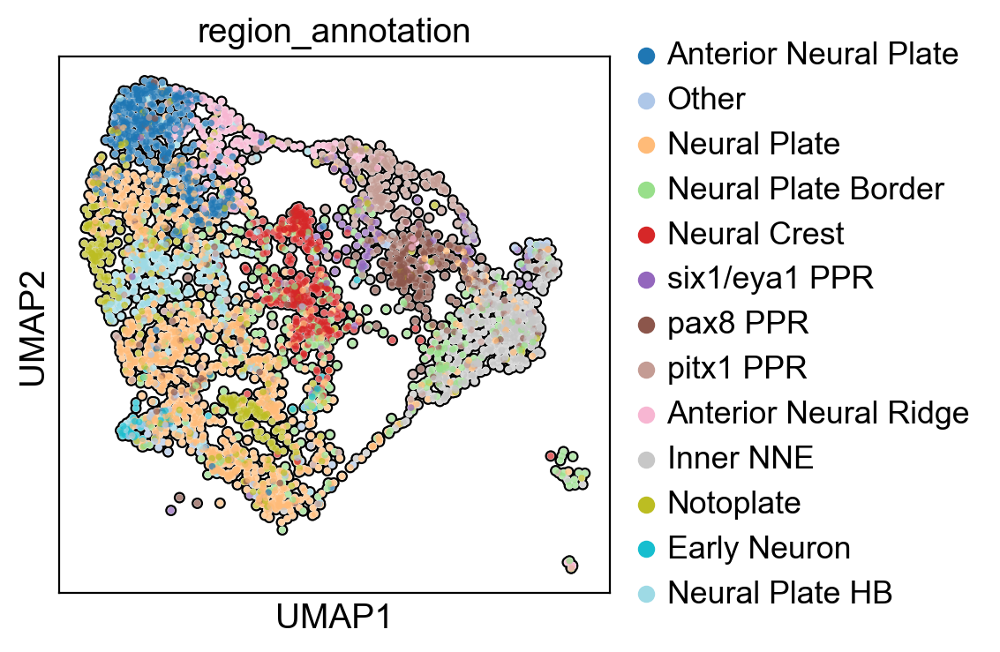

In [170]:
# Define expression threshold for pax2
threshold_pax2 = 1  # Adjust if needed

# Add the new category for Neural Plate HB
innerecto_subset.obs['region_annotation'] = innerecto_subset.obs['region_annotation'].cat.add_categories(['Neural Plate HB'])

# Create mask for high pax2 expression
pax2_mask = (innerecto_subset[:, 'pax2'].X > threshold_pax2).toarray().flatten()

# Mask for cells labeled "Neural Plate" or "Other"
mask_allowed = innerecto_subset.obs['region_annotation'].isin(['Neural Plate', 'Other'])

# Combine the conditions: high pax2 expression and allowed cell annotations
expression_mask = pax2_mask & mask_allowed

# Apply the new label to the matching cells
innerecto_subset.obs.loc[expression_mask, 'region_annotation'] = 'Neural Plate HB'

# Visualize the result
sc.pl.umap(innerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


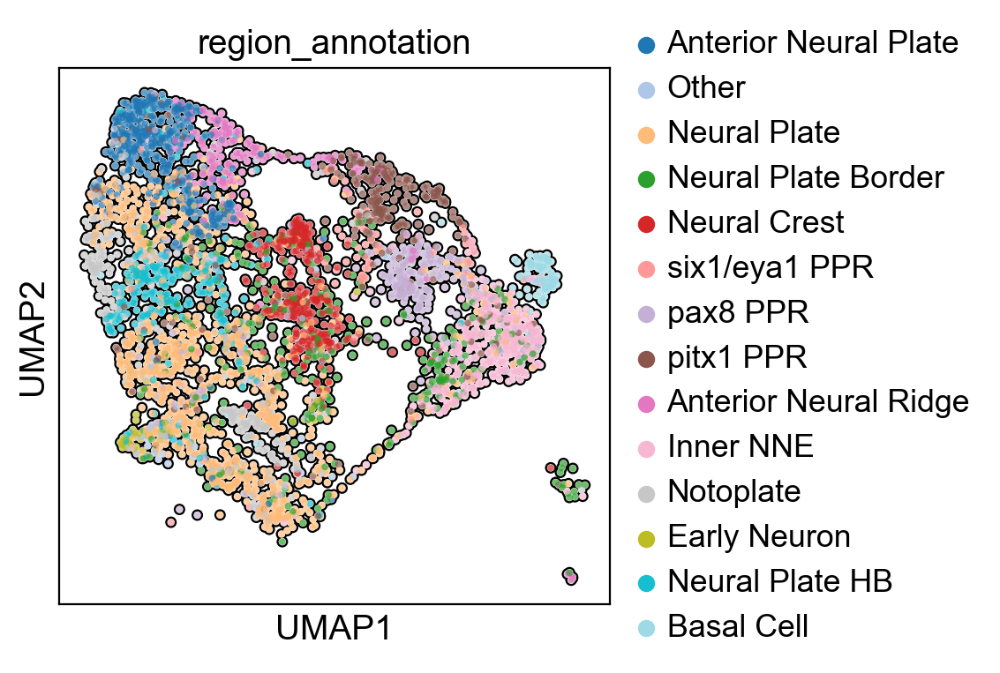

In [219]:
# Define expression threshold for FOXA1 and POU2F3
threshold_foxa1 = 1  # Adjust if needed
threshold_pou2f3 = 1  # Adjust if needed

# Add the new category for Basal Cell
innerecto_subset.obs['region_annotation'] = innerecto_subset.obs['region_annotation'].cat.add_categories(['Basal Cell'])

# Create masks for high FOXA1 and POU2F3 expression
foxa1_mask = (innerecto_subset[:, 'foxa1'].X > threshold_foxa1).toarray().flatten()
pou2f3_mask = (innerecto_subset[:, 'pou2f3'].X > threshold_pou2f3).toarray().flatten()

# Combine the conditions: high FOXA1 **and** POU2F3 expression (AND logic)
expression_mask = foxa1_mask & pou2f3_mask

# Apply the new label "Basal Cell" to the matching cells
innerecto_subset.obs.loc[expression_mask, 'region_annotation'] = 'Basal Cell'

# Visualize the result
sc.pl.umap(innerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


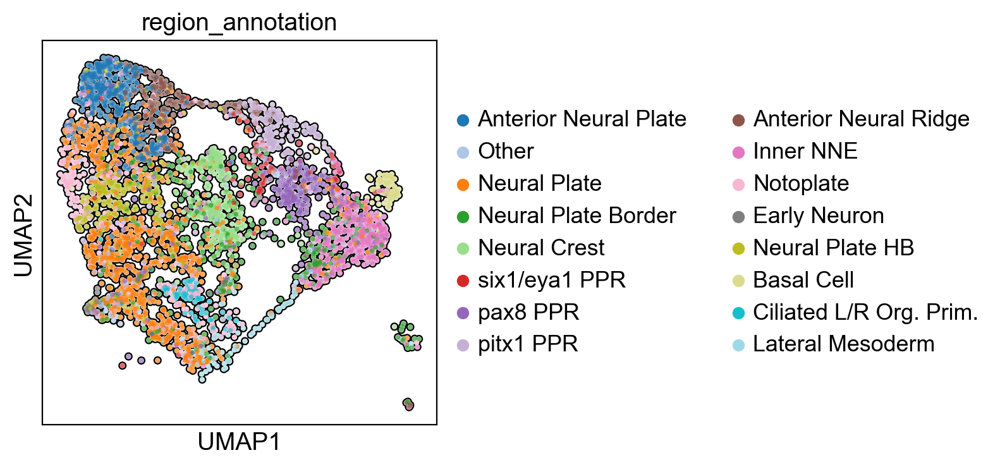

In [790]:
# Define expression threshold for TBXT
threshold_tbxt = 1.5  # Adjust as needed

# Add "Lateral Mesoderm" category if it doesn't exist already
if 'Lateral Mesoderm' not in innerecto_subset.obs['region_annotation'].cat.categories:
    innerecto_subset.obs['region_annotation'] = innerecto_subset.obs['region_annotation'].cat.add_categories(['Lateral Mesoderm'])

# Create TBXT expression mask
tbxt_mask = (innerecto_subset[:, 'tbxt'].X > threshold_tbxt).toarray().flatten()

# Apply the new label
innerecto_subset.obs.loc[tbxt_mask, 'region_annotation'] = 'Lateral Mesoderm'

# Visualize the updated annotations
sc.pl.umap(innerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


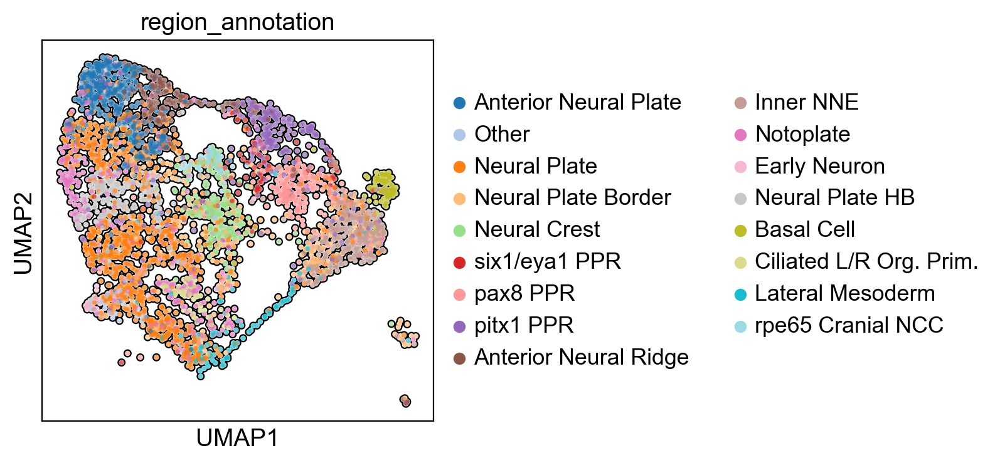

In [796]:
# Define expression threshold for RPE65
threshold_rpe65 = 1  # Adjust as needed

# Add "rpe65 Cranial NCC" category if not already present
if 'rpe65 Cranial NCC' not in innerecto_subset.obs['region_annotation'].cat.categories:
    innerecto_subset.obs['region_annotation'] = innerecto_subset.obs['region_annotation'].cat.add_categories(['rpe65 Cranial NCC'])

# Create expression mask for RPE65
rpe65_mask = (innerecto_subset[:, 'rpe65'].X > threshold_rpe65).toarray().flatten()

# Restrict to cells already labeled "Neural Crest"
neural_crest_mask = innerecto_subset.obs['region_annotation'] == 'Neural Crest'

# Combine masks: high RPE65 AND currently Neural Crest
rpe65_ncc_mask = rpe65_mask & neural_crest_mask

# Apply the new label
innerecto_subset.obs.loc[rpe65_ncc_mask, 'region_annotation'] = 'rpe65 Cranial NCC'

# Visualize the result
sc.pl.umap(innerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


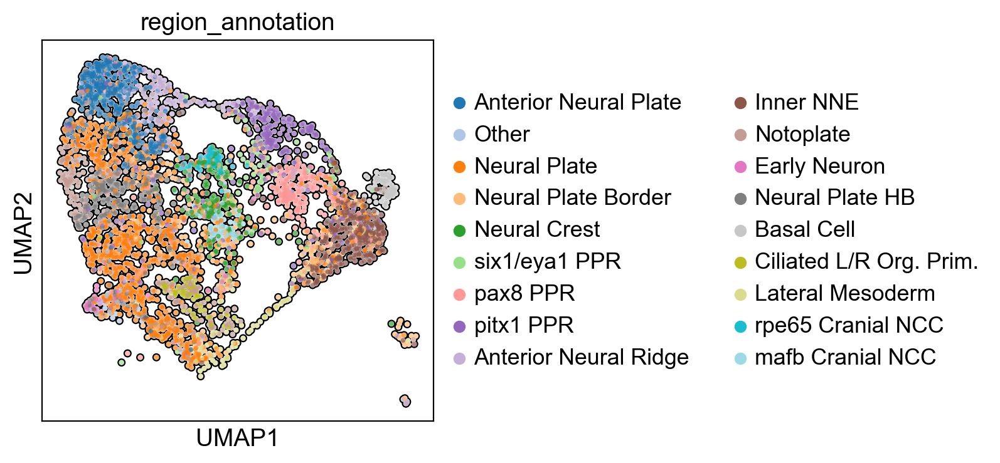

In [798]:
# Define expression threshold for MAFB
threshold_mafb = 1.25  # Adjust as needed

# Add "mafb Cranial NCC" category if not already present
if 'mafb Cranial NCC' not in innerecto_subset.obs['region_annotation'].cat.categories:
    innerecto_subset.obs['region_annotation'] = innerecto_subset.obs['region_annotation'].cat.add_categories(['mafb Cranial NCC'])

# Create expression mask for MAFB
mafb_mask = (innerecto_subset[:, 'mafb'].X > threshold_mafb).toarray().flatten()

# Restrict to cells already labeled "Neural Crest"
neural_crest_mask = innerecto_subset.obs['region_annotation'] == 'Neural Crest'

# Combine masks: high MAFB AND currently Neural Crest
mafb_ncc_mask = mafb_mask & neural_crest_mask

# Apply the new label
innerecto_subset.obs.loc[mafb_ncc_mask, 'region_annotation'] = 'mafb Cranial NCC'

# Visualize the result
sc.pl.umap(innerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


computing neighbors
    finished (0:00:00)


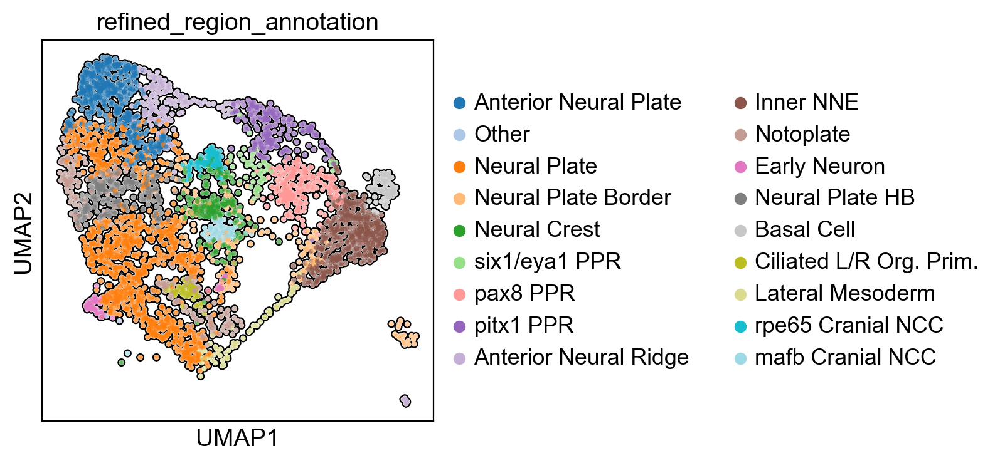

In [799]:
import scanpy as sc
import numpy as np
import pandas as pd

# 1. Calculate nearest neighbors (KNN graph) - Don't change the positions, only labels
sc.pp.neighbors(innerecto_subset, n_neighbors=20, use_rep='X_pca')  # Ensure you're using the correct representation (e.g., PCA)

# 2. Get the original cluster labels (assuming you've already run clustering)
original_labels = innerecto_subset.obs['region_annotation'].copy()

# 3. For each cell, check the majority label of its neighbors and assign the new label
new_labels = original_labels.copy()  # Start with the original labels

# Access the KNN graph (stored in the AnnData object as 'neighbors')
neighbors = innerecto_subset.obsp['distances']  # distances matrix for all pairs of cells
connectivities = innerecto_subset.obsp['connectivities']  # adjacency matrix (which neighbors are connected)

# Loop through all cells and update their labels based on the majority of their neighbors
for i, cell in enumerate(innerecto_subset.obs.index):
    # Get the neighbors of the current cell (index `i`)
    neighbor_indices = connectivities[i].indices  # Indices of neighbors for cell `i`
    neighbor_labels = original_labels.iloc[neighbor_indices]  # Labels of the neighbors
    
    # Assign the most common label among the neighbors
    most_common_label = neighbor_labels.mode()[0]  # The most frequent label among neighbors
    new_labels.iloc[i] = most_common_label  # Update the label

# Assign the new refined labels to the object
innerecto_subset.obs['refined_region_annotation'] = new_labels

# 4. Visualize the refined labels on UMAP
sc.pl.umap(innerecto_subset, color='refined_region_annotation', add_outline=True, palette="tab20")


In [242]:
# Get gene names as a list of strings
cluster_19_gene_list = [str(gene) for gene in result['names']['16'][:100]]

for i in range(0, len(cluster_19_gene_list), 10):  # 10 at a time
    chunk = cluster_19_gene_list[i:i+10]
    print(", ".join(f'"{gene}"' for gene in chunk))


"hoxd3", "nradd", "eda", "hoxc9", "LOC100216241", "sall1", "sulf1", "hoxa9", "hoxa3", "cdx4"
"cdx2", "XB5872372", "greb1", "hoxb7", "kif26a", "col13a1", "nid2", "hoxd4", "arid3a", "sall3"
"rarg", "mllt3", "LOC116411472", "rspo3", "cdx1", "lamb1", "trim71", "wnt3a", "prex1", "hoxb3"
"wnt4", "LOC100498064", "LOC116411597", "hoxc6", "spry4", "znrf3", "tshz3", "sp5l", "ltbp1", "prickle1"
"hoxc10", "robo1", "tdrp", "bicc1", "epha2", "gdf11", "fn1", "fbln1", "hoxc8", "prickle2"
"cdh2", "etv1", "hoxa7", "rnf220.2", "LOC100488690", "fat1", "hoxb6", "sap30", "wnt5b", "fam222a"
"sema6a", "pkp4", "hoxc5", "anks6", "LOC100498593", "syngap1", "st3gal6", "hoxc4", "hoxa4", "st3gal8"
"ptpru", "ddr1", "hoxb8", "plekhg3", "emid1", "adamts18", "LOC101733854", "rbm20", "camk4", "ror2"
"sh3pxd2a", "itgb4", "ptgs2", "crabp2", "hoxa10", "LOC100490346", "efnb2", "tnfrsf19", "gprc5b", "axin2l"
"lhfpl2", "tshz1", "prdm5", "zfp36l2.1", "cxadr", "lmo4", "fgf8", "nav1", "rxra", "frmd3"


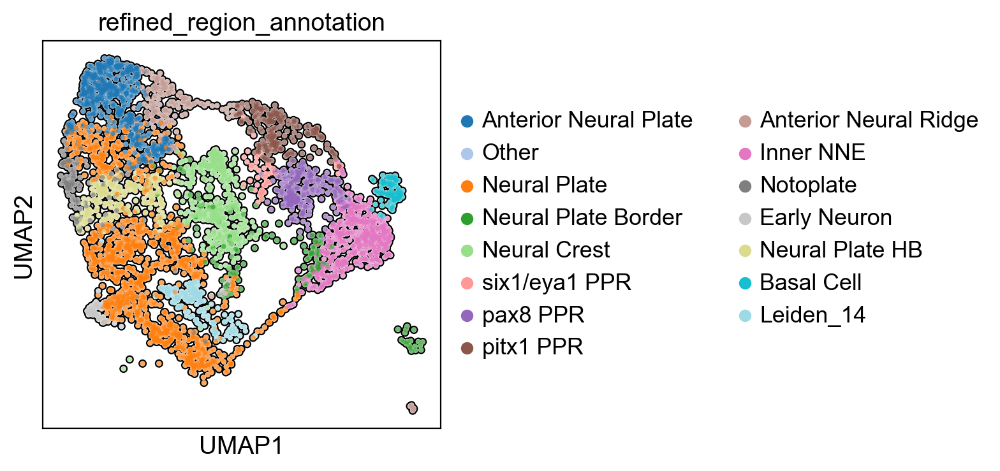

In [737]:
# Make sure 'refined_region_annotation' column exists and has category '14_leiden'
if 'refined_region_annotation' not in innerecto_subset.obs.columns:
    innerecto_subset.obs['refined_region_annotation'] = 'Other'
    innerecto_subset.obs['refined_region_annotation'] = innerecto_subset.obs['refined_region_annotation'].astype('category')

# Define new label name
new_label = 'Leiden_14'

# Add the new label category if not already present
innerecto_subset.obs['refined_region_annotation'] = innerecto_subset.obs['refined_region_annotation'].cat.add_categories([new_label])

# Create a mask for cells in cluster 14
leiden_14_mask = innerecto_subset.obs['leiden_1.0'] == '14'

# Apply the label
innerecto_subset.obs.loc[leiden_14_mask, 'refined_region_annotation'] = new_label

# Optional: visualize to confirm
sc.pl.umap(innerecto_subset, color='refined_region_annotation', add_outline=True, palette="tab20")


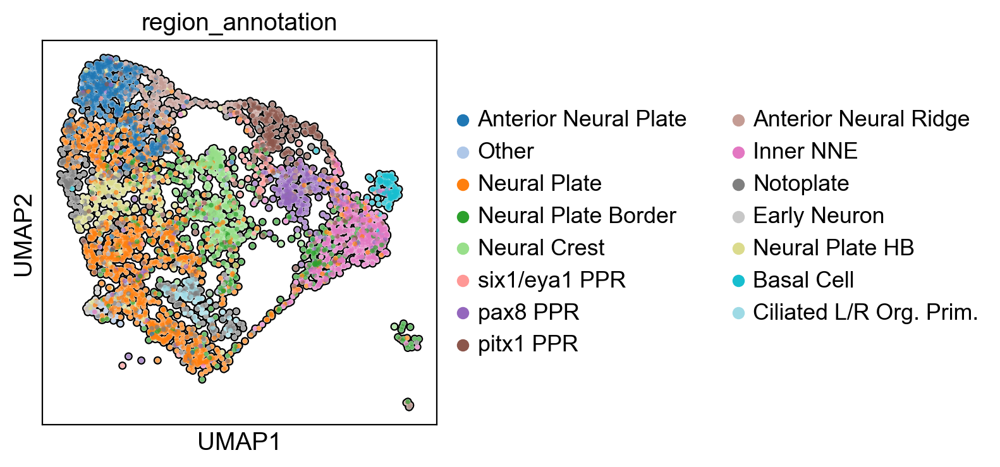

In [739]:
# Step 1: Add 'Ciliated L/R Org. Prim.' if not already a category
if 'Ciliated L/R Org. Prim.' not in innerecto_subset.obs['region_annotation'].cat.categories:
    innerecto_subset.obs['region_annotation'] = innerecto_subset.obs['region_annotation'].cat.add_categories(['Ciliated L/R Org. Prim.'])

# Step 2: Define foxj1 expression threshold
threshold_foxj1 = 1  # Adjust as needed

# Step 3: Mask for cluster 14
leiden_14_mask = innerecto_subset.obs['leiden_1.0'] == '14'

# Step 4: Mask for high foxj1 expression
foxj1_mask = (innerecto_subset[:, 'foxj1'].X > threshold_foxj1).toarray().flatten()

# Step 5: Cells in cluster 14 *and* high foxj1 → 'Ciliated L/R Org. Prim.'
ciliated_mask = leiden_14_mask & foxj1_mask
innerecto_subset.obs.loc[ciliated_mask, 'region_annotation'] = 'Ciliated L/R Org. Prim.'

# Step 6: Remaining cells in cluster 14 (that weren't labeled above) → 'Notoplate'
notoplate_mask = leiden_14_mask & ~foxj1_mask
innerecto_subset.obs.loc[notoplate_mask, 'region_annotation'] = 'Notoplate'

# Step 7: Visualize
sc.pl.umap(innerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


computing neighbors
    finished (0:00:00)


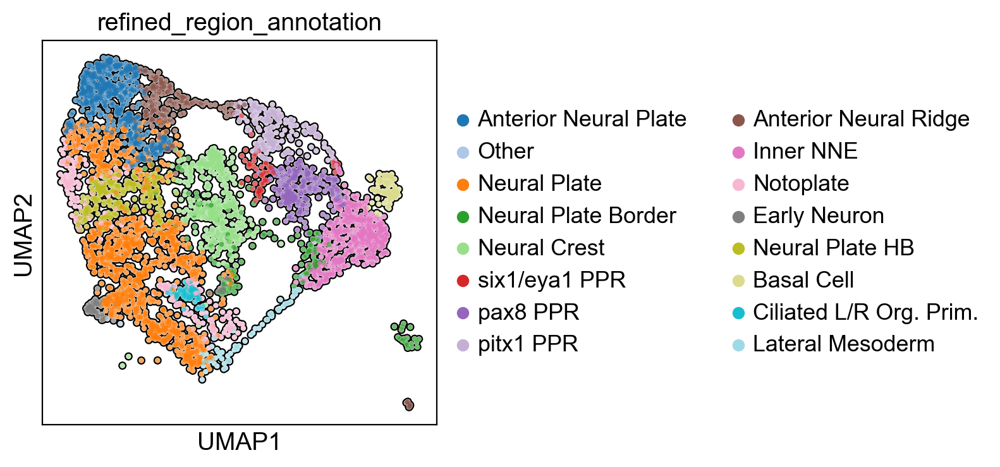

In [792]:
import scanpy as sc
import numpy as np
import pandas as pd

# 1. Calculate nearest neighbors (KNN graph) - Don't change the positions, only labels
sc.pp.neighbors(innerecto_subset, n_neighbors=20, use_rep='X_pca')  # Ensure you're using the correct representation (e.g., PCA)

# 2. Get the original cluster labels (assuming you've already run clustering)
original_labels = innerecto_subset.obs['region_annotation'].copy()

# 3. For each cell, check the majority label of its neighbors and assign the new label
new_labels = original_labels.copy()  # Start with the original labels

# Access the KNN graph (stored in the AnnData object as 'neighbors')
neighbors = innerecto_subset.obsp['distances']  # distances matrix for all pairs of cells
connectivities = innerecto_subset.obsp['connectivities']  # adjacency matrix (which neighbors are connected)

# Loop through all cells and update their labels based on the majority of their neighbors
for i, cell in enumerate(innerecto_subset.obs.index):
    # Get the neighbors of the current cell (index `i`)
    neighbor_indices = connectivities[i].indices  # Indices of neighbors for cell `i`
    neighbor_labels = original_labels.iloc[neighbor_indices]  # Labels of the neighbors
    
    # Assign the most common label among the neighbors
    most_common_label = neighbor_labels.mode()[0]  # The most frequent label among neighbors
    new_labels.iloc[i] = most_common_label  # Update the label

# Assign the new refined labels to the object
innerecto_subset.obs['refined_region_annotation'] = new_labels

# 4. Visualize the refined labels on UMAP
sc.pl.umap(innerecto_subset, color='refined_region_annotation', add_outline=True, palette="tab20")


computing neighbors
    finished (0:00:00)


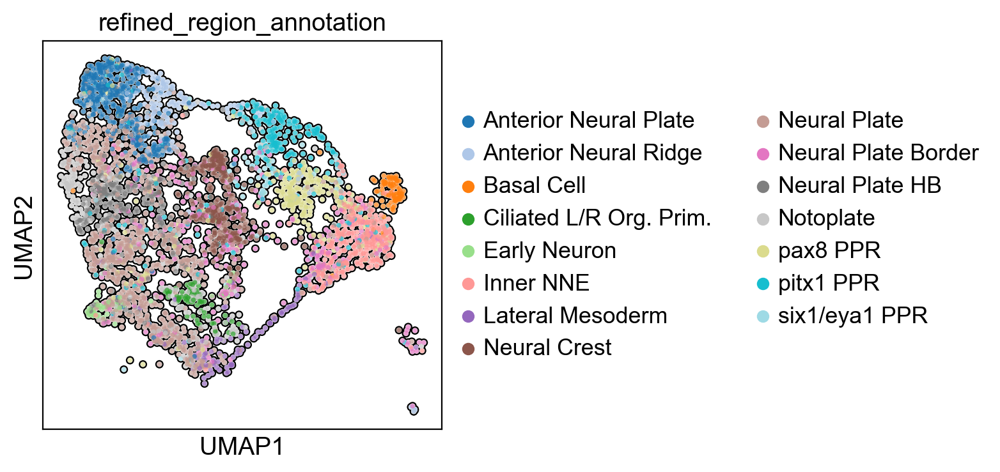

In [793]:
import scanpy as sc
import numpy as np

# 1. Compute neighbors
sc.pp.neighbors(innerecto_subset, n_neighbors=5, use_rep='X_pca')

# 2. Backup original annotations
original_labels = innerecto_subset.obs['region_annotation'].copy()
new_labels = original_labels.copy()

# 3. Access connectivities
connectivities = innerecto_subset.obsp['connectivities']

# 4. Loop through cells and update only if label is "Other"
for i, cell in enumerate(innerecto_subset.obs.index):
    if original_labels.iloc[i] == "Other":
        neighbor_indices = connectivities[i].indices
        neighbor_labels = original_labels.iloc[neighbor_indices]
        
        # Exclude "Other" from neighbors
        neighbor_labels = neighbor_labels[neighbor_labels != "Other"]
        if not neighbor_labels.empty:
            most_common_label = neighbor_labels.mode()[0]
            new_labels.iloc[i] = most_common_label

# 5. Assign updated labels
innerecto_subset.obs['refined_region_annotation'] = new_labels

# 6. Remove "Other" from categories
innerecto_subset.obs['refined_region_annotation'] = innerecto_subset.obs['refined_region_annotation'].cat.remove_categories(['Other'])

# 7. Visualize the result
sc.pl.umap(innerecto_subset, color='refined_region_annotation', add_outline=True, palette="tab20")


computing neighbors
    finished (0:00:00)


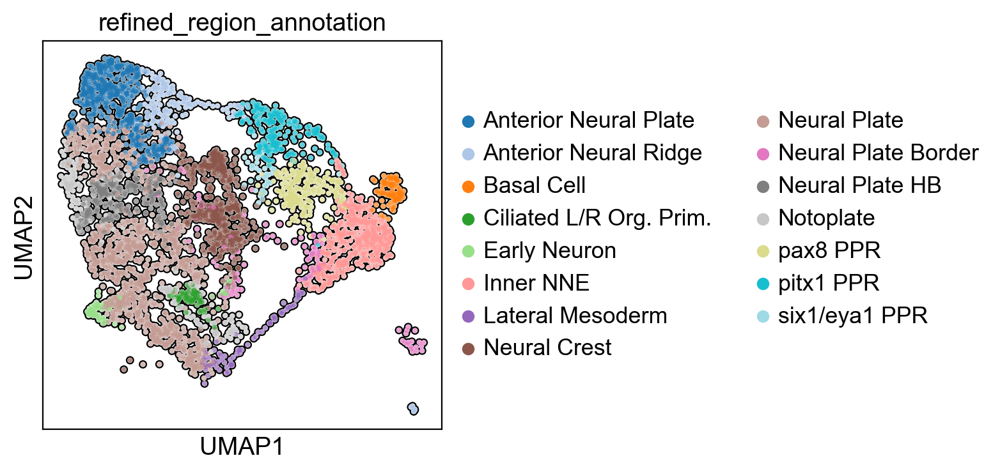

In [794]:
import scanpy as sc
import numpy as np
import pandas as pd

# 1. Calculate nearest neighbors (KNN graph) - Don't change the positions, only labels
sc.pp.neighbors(innerecto_subset, n_neighbors=20, use_rep='X_pca')  # Ensure you're using the correct representation (e.g., PCA)

# 2. Get the original cluster labels (assuming you've already run clustering)
original_labels = innerecto_subset.obs['refined_region_annotation'].copy()

# 3. For each cell, check the majority label of its neighbors and assign the new label
new_labels = original_labels.copy()  # Start with the original labels

# Access the KNN graph (stored in the AnnData object as 'neighbors')
neighbors = innerecto_subset.obsp['distances']  # distances matrix for all pairs of cells
connectivities = innerecto_subset.obsp['connectivities']  # adjacency matrix (which neighbors are connected)

# Loop through all cells and update their labels based on the majority of their neighbors
for i, cell in enumerate(innerecto_subset.obs.index):
    # Get the neighbors of the current cell (index `i`)
    neighbor_indices = connectivities[i].indices  # Indices of neighbors for cell `i`
    neighbor_labels = original_labels.iloc[neighbor_indices]  # Labels of the neighbors
    
    # Assign the most common label among the neighbors
    most_common_label = neighbor_labels.mode()[0]  # The most frequent label among neighbors
    new_labels.iloc[i] = most_common_label  # Update the label

# Assign the new refined labels to the object
innerecto_subset.obs['refined_region_annotation'] = new_labels

# 4. Visualize the refined labels on UMAP
sc.pl.umap(innerecto_subset, color='refined_region_annotation', add_outline=True, palette="tab20")


### Outer Ectoderm (before Endoderm) ###

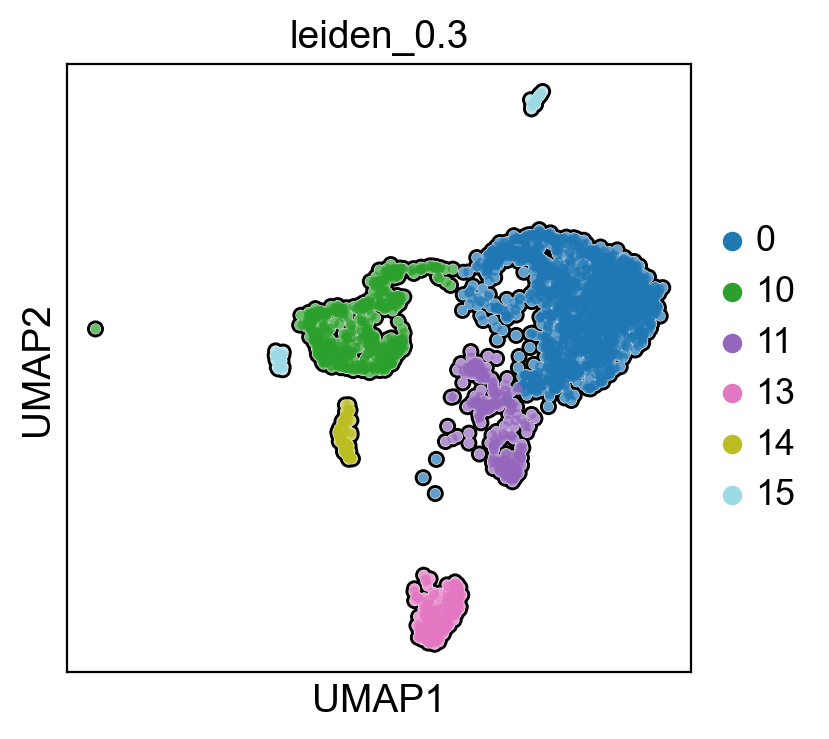

In [252]:
# Define the cluster labels you want to keep
selected_clusters = ['0', '10', '11', '14', '15', '13']

# Subset the AnnData object based on the leiden_0.1 column
outerecto_subset = corr_data[corr_data.obs['leiden_0.3'].isin(selected_clusters)].copy()
sc.pl.umap(outerecto_subset, color = "leiden_0.3", add_outline=True, palette="tab20")

In [255]:
sc.tl.leiden(outerecto_subset, key_added = "leiden_0.3") # default resolution in 1.0
sc.tl.leiden(outerecto_subset, resolution = 0.3, key_added = "leiden_0.3")

running Leiden clustering
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)


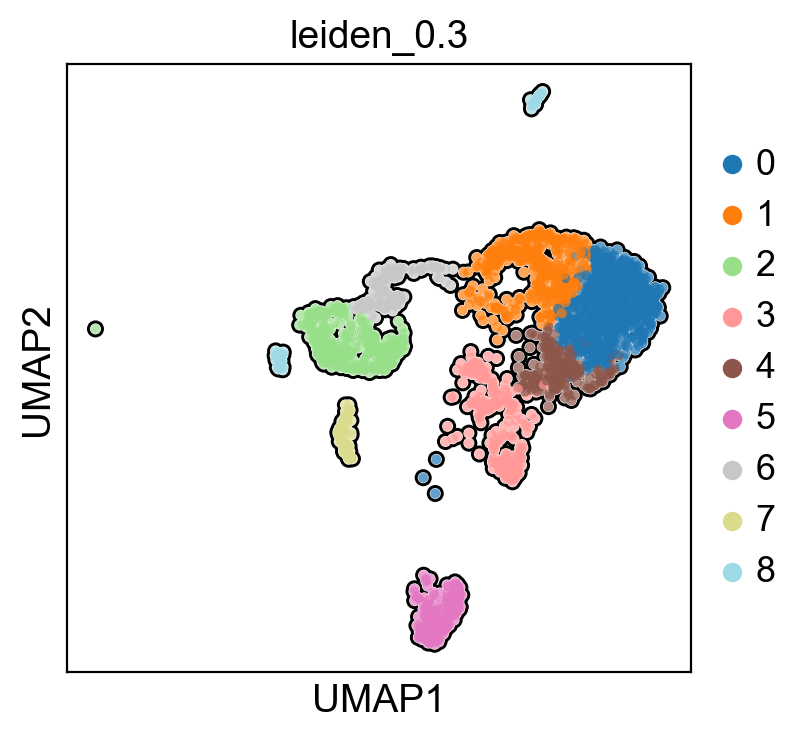

In [256]:
sc.pl.umap(outerecto_subset, color = "leiden_0.3", add_outline=True, palette="tab20")

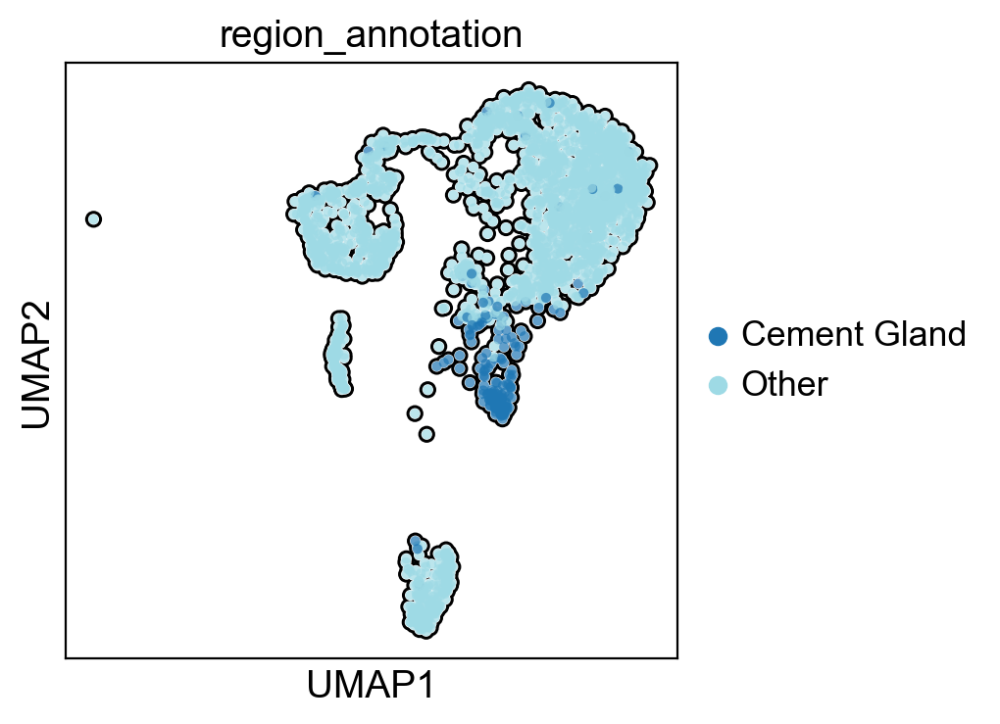

In [766]:
sc.tl.rank_genes_groups(outerecto_subset, groupby='leiden_0.3', n_genes=100, method='t-test')  # or whatever method you used
sc.pl.rank_genes_groups(outerecto_subset, n_genes=20, sharey=False)

# Define a threshold for "high" expression
threshold = 1  # adjust based on your data (you might use 0.5, 1, or a quantile)

# Logical mask: cells where both rax and pax6 are highly expressed
mask = (outerecto_subset[:, 'agr2'].X > threshold).toarray().flatten() & \
       (outerecto_subset[:, 'pitx1'].X > threshold).toarray().flatten()

# Create a new column for annotation if it doesn't exist
outerecto_subset.obs['region_annotation'] = 'Other'

# Assign "Anterior Neural Plate" to cells meeting the condition
outerecto_subset.obs.loc[mask, 'region_annotation'] = 'Cement Gland'
sc.pl.umap(outerecto_subset, color = "region_annotation", add_outline=True, palette="tab20")

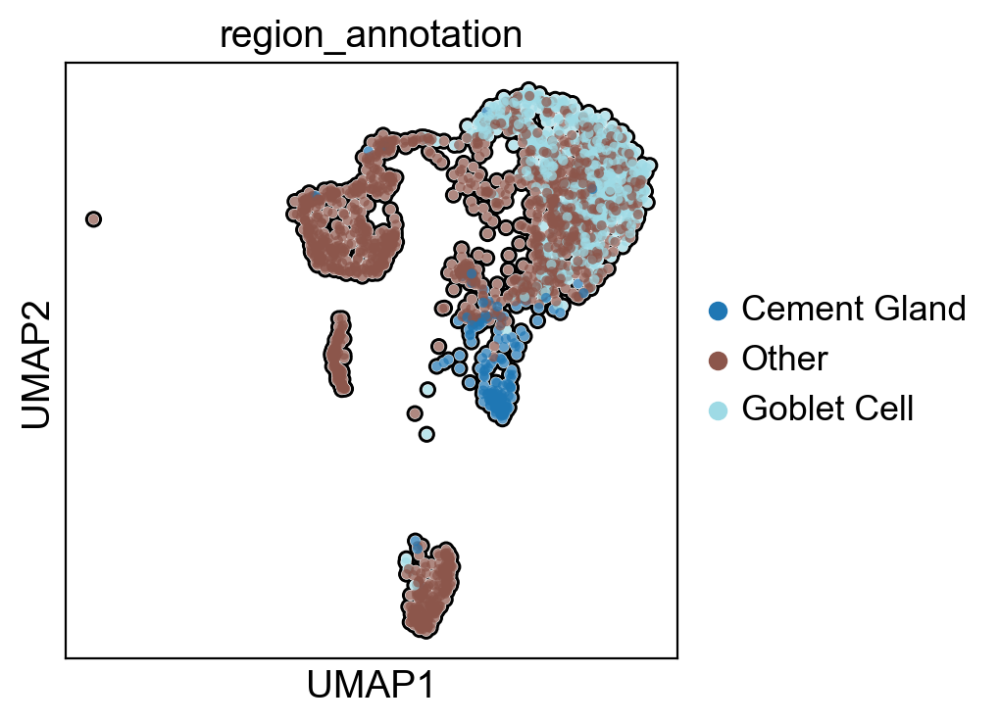

In [767]:
# Define expression threshold for FOXA1 and POU2F3
threshold_itln1 = .5  # Adjust if needed
threshold_itln2 = .5 # Adjust if needed

# Add the new category for Basal Cell
outerecto_subset.obs['region_annotation'] = outerecto_subset.obs['region_annotation'].cat.add_categories(['Goblet Cell'])

# Create masks for high FOXA1 and POU2F3 expression
itln1_mask = (outerecto_subset[:, 'itln1'].X > threshold_foxa1).toarray().flatten()
itln2_mask = (outerecto_subset[:, 'itln2'].X > threshold_pou2f3).toarray().flatten()

# Combine the conditions: high FOXA1 **and** POU2F3 expression (AND logic)
expression_mask = itln1_mask & itln2_mask

# Apply the new label "Basal Cell" to the matching cells
outerecto_subset.obs.loc[expression_mask, 'region_annotation'] = 'Goblet Cell'

# Visualize the result
sc.pl.umap(outerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


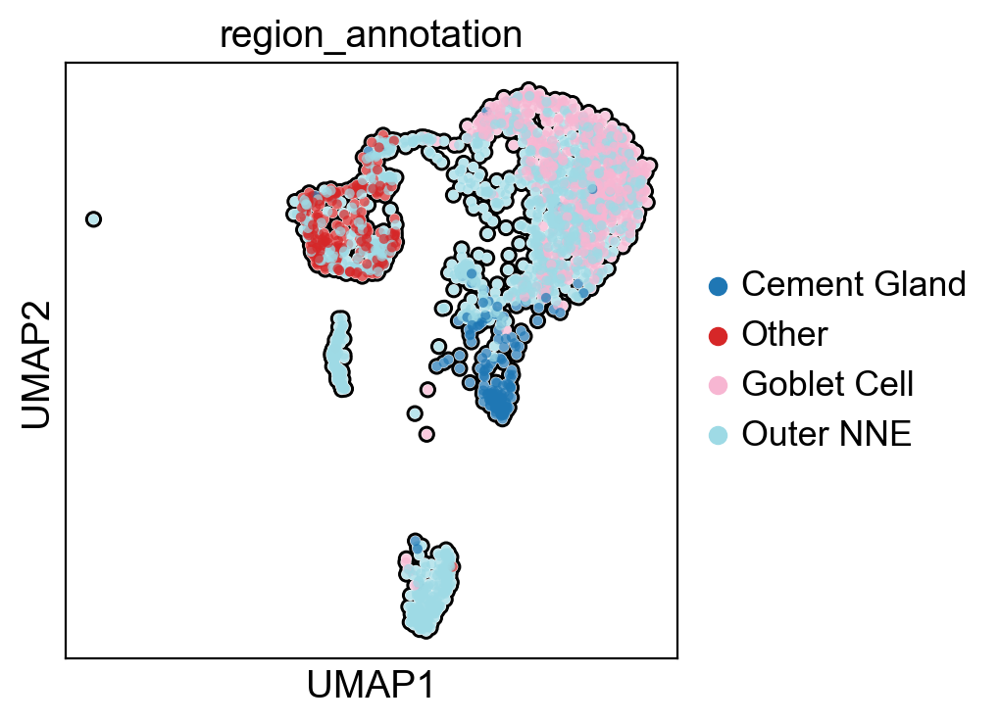

In [768]:
# Define expression threshold for KRT70
threshold_krt70 = 1  # Adjust if needed

# Add new category "Outer NNE"
outerecto_subset.obs['region_annotation'] = outerecto_subset.obs['region_annotation'].cat.add_categories(['Outer NNE'])

# Create mask for high KRT70 expression
krt70_mask = (outerecto_subset[:, 'krt70'].X > threshold_krt70).toarray().flatten()

# Mask to exclude cells already labeled as Goblet Cell or Cement Gland
not_goblet_or_cement = ~outerecto_subset.obs['region_annotation'].isin(['Goblet Cell', 'Cement Gland'])

# Final mask: High KRT70 expression AND not already Goblet or Cement Gland
nne_mask = krt70_mask & not_goblet_or_cement

# Assign "Outer NNE" label to those cells
outerecto_subset.obs.loc[nne_mask, 'region_annotation'] = 'Outer NNE'

# Visualize the result
sc.pl.umap(outerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


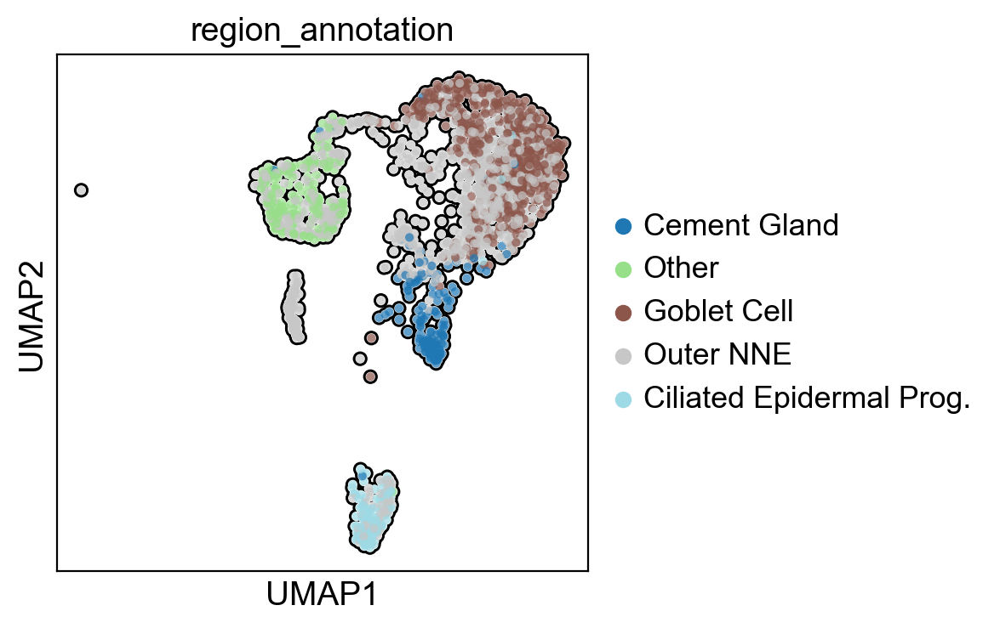

In [769]:
# Define expression thresholds for FOXJ1 and TP73
threshold_foxj1 = .5
threshold_tp73 = .5

# Add the new category "Ciliated Epidermal Prog."
outerecto_subset.obs['region_annotation'] = outerecto_subset.obs['region_annotation'].cat.add_categories(['Ciliated Epidermal Prog.'])

# Create masks for high FOXJ1 and TP73 expression
foxj1_mask = (outerecto_subset[:, 'foxj1'].X > threshold_foxj1).toarray().flatten()
tp73_mask = (outerecto_subset[:, 'tp73'].X > threshold_tp73).toarray().flatten()

# Combine masks (AND logic)
ciliated_mask = foxj1_mask & tp73_mask

# Optional: prevent overwriting certain existing labels (uncomment if needed)
# protect_labels = ['Goblet Cell', 'Cement Gland', 'Outer NNE']
# not_protected = ~outerecto_subset.obs['region_annotation'].isin(protect_labels)
# ciliated_mask = ciliated_mask & not_protected

# Assign new label
outerecto_subset.obs.loc[ciliated_mask, 'region_annotation'] = 'Ciliated Epidermal Prog.'

# Visualize updated annotations
sc.pl.umap(outerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


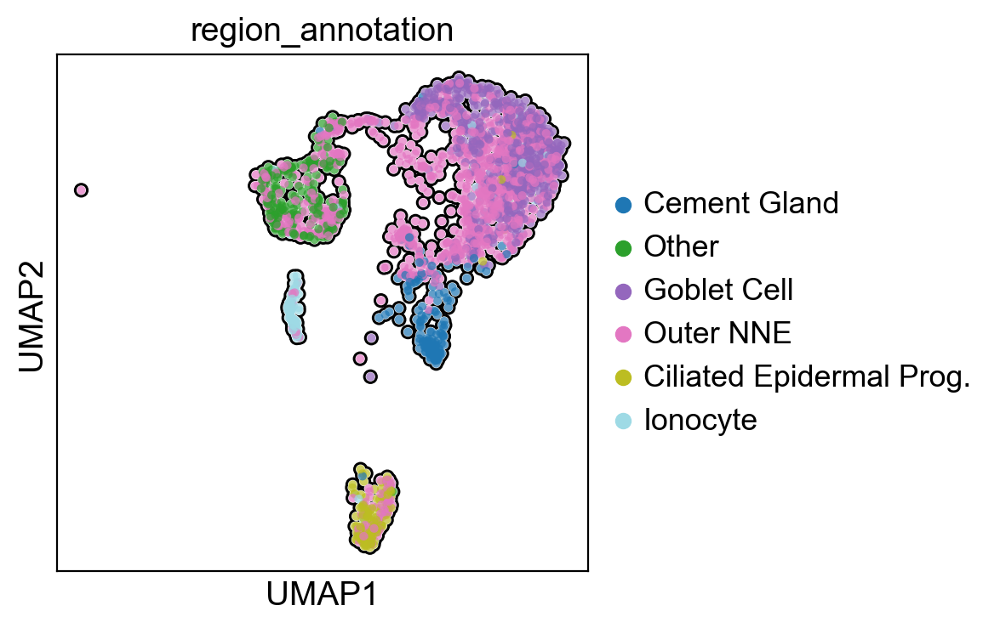

In [770]:
# Define expression threshold for FOXI1
threshold_foxi1 = 1  # Adjust if needed

# Add the new category "Ionocyte"
outerecto_subset.obs['region_annotation'] = outerecto_subset.obs['region_annotation'].cat.add_categories(['Ionocyte'])

# Create mask for high FOXI1 expression
foxi1_mask = (outerecto_subset[:, 'foxi1'].X > threshold_foxi1).toarray().flatten()

# Optional: prevent overwriting certain existing labels
# protect_labels = ['Goblet Cell', 'Cement Gland', 'Outer NNE', 'Ciliated Epidermal Prog.']
# not_protected = ~outerecto_subset.obs['region_annotation'].isin(protect_labels)
# ionocyte_mask = foxi1_mask & not_protected

# If you're okay with assigning Ionocyte even if other labels exist, just use this:
ionocyte_mask = foxi1_mask

# Assign "Ionocyte" label to the matching cells
outerecto_subset.obs.loc[ionocyte_mask, 'region_annotation'] = 'Ionocyte'

# Visualize the result
sc.pl.umap(outerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


### Endoderm (after Outer Ectoderm) ###

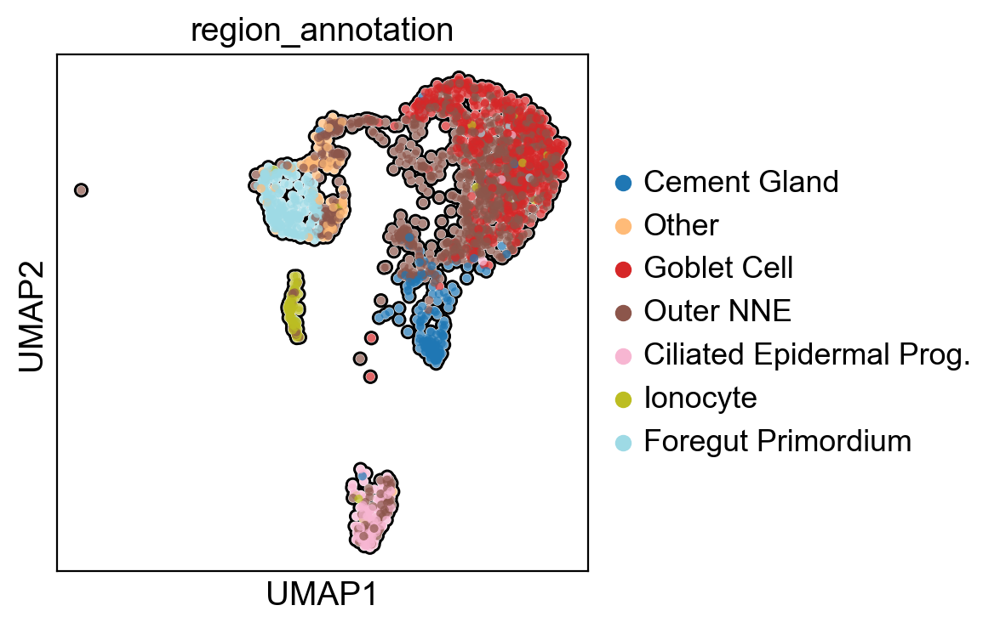

In [771]:
# Define expression threshold for SLC5A8
threshold_slc5a8 = 2  # Adjust as needed

# Add the new category "Foregut Primordium"
outerecto_subset.obs['region_annotation'] = outerecto_subset.obs['region_annotation'].cat.add_categories(['Foregut Primordium'])

# Create mask for high SLC5A8 expression
slc5a8_mask = (outerecto_subset[:, 'slc5a8'].X > threshold_slc5a8).toarray().flatten()

# Mask to prevent overwriting Hindgut Primordium
not_hindgut = outerecto_subset.obs['region_annotation'] != 'Hindgut Primordium'

# Combine the conditions: high SLC5A8 expression and not already Hindgut
foregut_mask = slc5a8_mask & not_hindgut

# Assign the new label
outerecto_subset.obs.loc[foregut_mask, 'region_annotation'] = 'Foregut Primordium'

# Visualize the updated annotations
sc.pl.umap(outerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


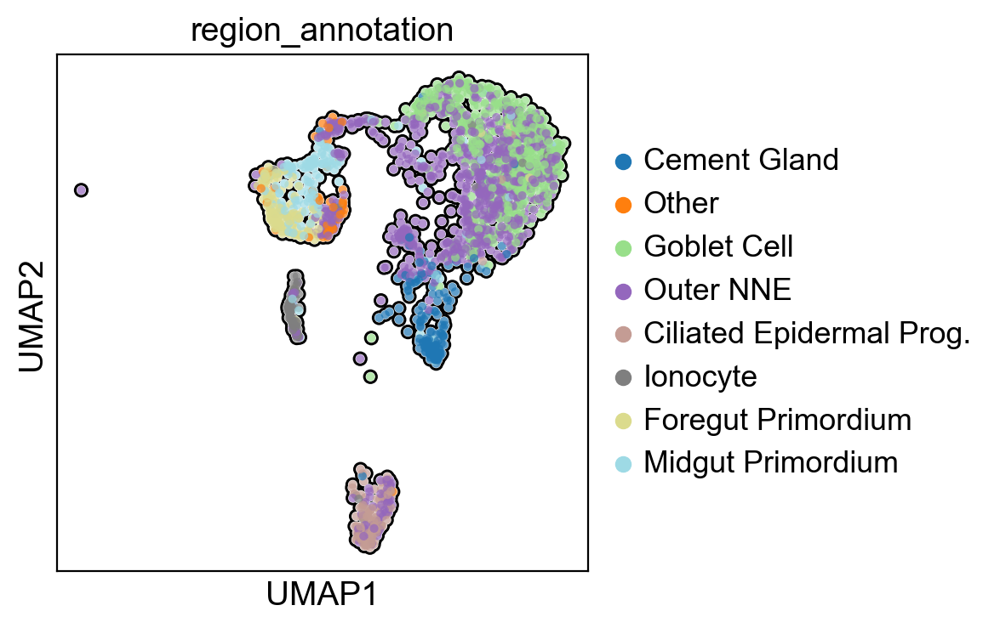

In [772]:
# Define expression threshold for NDRG1
threshold_ndrg1 = 1  # Adjust if needed

# Add the new category "Endoderm Hindgut Primordium"
outerecto_subset.obs['region_annotation'] = outerecto_subset.obs['region_annotation'].cat.add_categories(['Midgut Primordium'])

# Create mask for high NDRG1 expression
ndrg1_mask = (outerecto_subset[:, 'ndrg1'].X > threshold_ndrg1).toarray().flatten()

# Optional: prevent overwriting certain existing labels
# protect_labels = ['Goblet Cell', 'Cement Gland', 'Outer NNE', 'Ciliated Epidermal Prog.', 'Ionocyte']
# not_protected = ~outerecto_subset.obs['region_annotation'].isin(protect_labels)
# endoderm_mask = ndrg1_mask & not_protected

# If you're okay assigning regardless of existing label:
endoderm_mask = ndrg1_mask

# Assign the new label
outerecto_subset.obs.loc[endoderm_mask, 'region_annotation'] = 'Midgut Primordium'

# Visualize the updated annotation
sc.pl.umap(outerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


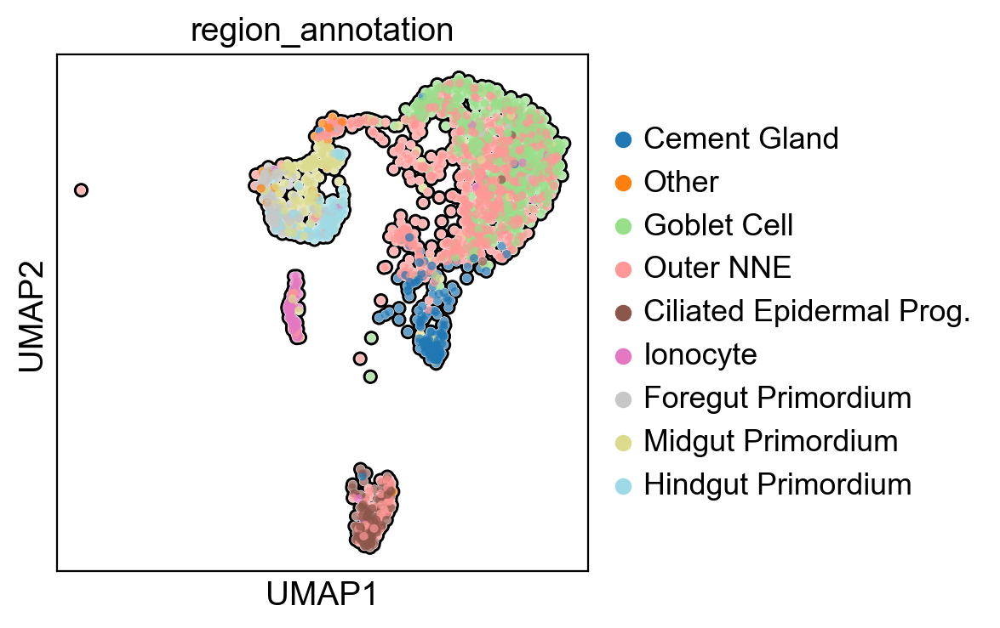

In [773]:
# Define expression threshold for GATM
threshold_gatm = 2  # Adjust as needed

# Ensure the category "Hindgut Primordium" exists
outerecto_subset.obs['region_annotation'] = outerecto_subset.obs['region_annotation'].cat.add_categories(['Hindgut Primordium'])

# Create mask for high GATM expression
gatm_mask = (outerecto_subset[:, 'gatm'].X > threshold_gatm).toarray().flatten()

# Allow overwrite if current label is one of these
allowed_to_overwrite = outerecto_subset.obs['region_annotation'].isin([
    'Foregut Primordium', 'Other', 'Outer NNE'
])

# Final mask: high GATM expression AND allowed annotation
overwrite_with_hindgut = gatm_mask & allowed_to_overwrite

# Apply new label
outerecto_subset.obs.loc[overwrite_with_hindgut, 'region_annotation'] = 'Hindgut Primordium'

# Visualize the result
sc.pl.umap(outerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


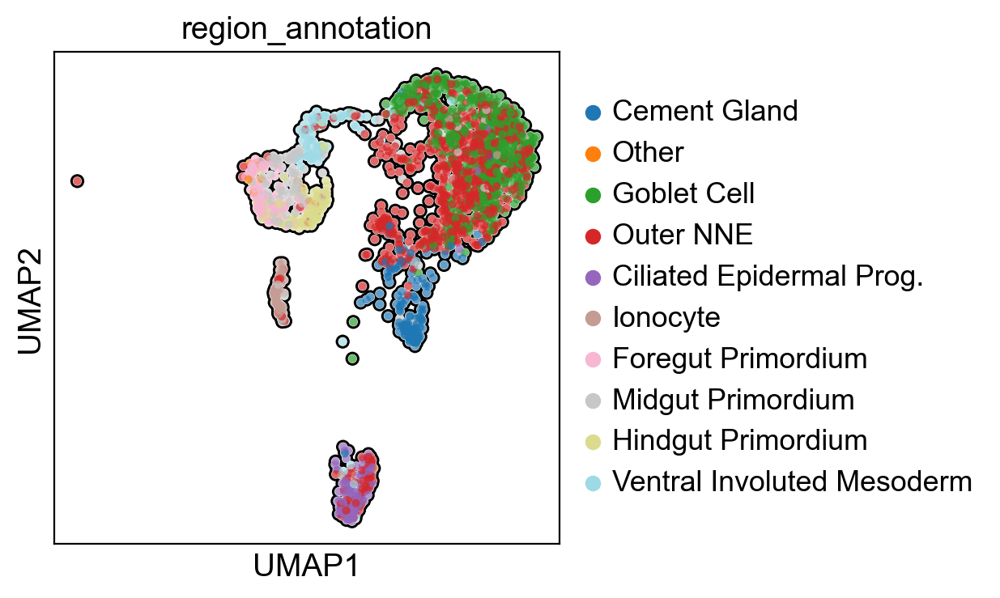

In [774]:
# Define expression thresholds
threshold_ventx = 1
threshold_tbxt = 1

# Add the new category
outerecto_subset.obs['region_annotation'] = outerecto_subset.obs['region_annotation'].cat.add_categories(['Ventral Involuted Mesoderm'])

# Create expression masks
ventx_mask = (outerecto_subset[:, 'cdx4'].X > threshold_ventx).toarray().flatten()
tbxt_mask = (outerecto_subset[:, 'tbxt'].X > threshold_tbxt).toarray().flatten()

# Combine with AND logic
tailbud_mask = ventx_mask & tbxt_mask

# Apply new label without any masking
outerecto_subset.obs.loc[tailbud_mask, 'region_annotation'] = 'Ventral Involuted Mesoderm'

# Visualize
sc.pl.umap(outerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


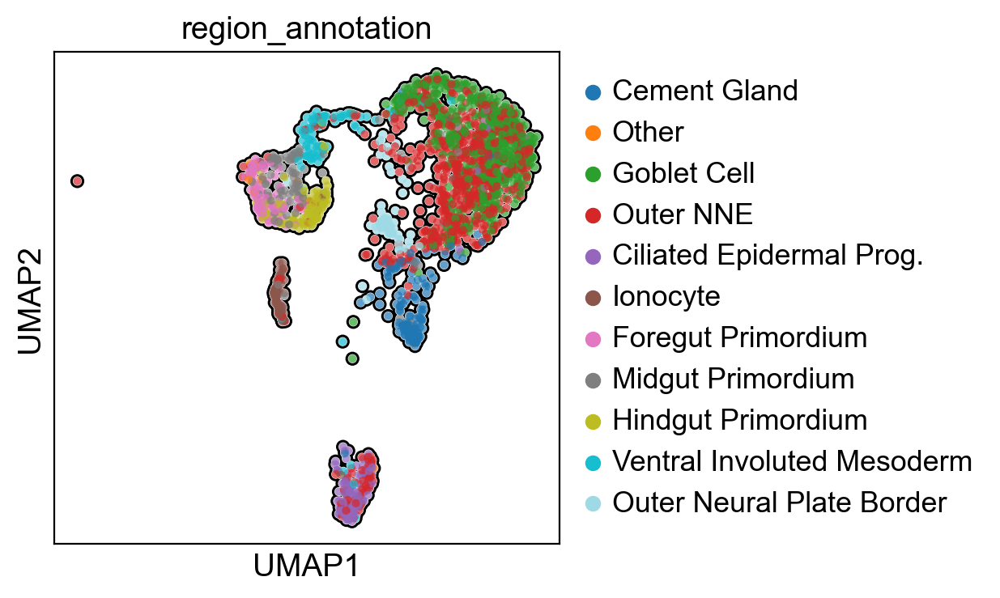

In [775]:
# Define expression threshold for PAX3
threshold_pax3 = 2  # Adjust if needed

# Add the new category
outerecto_subset.obs['region_annotation'] = outerecto_subset.obs['region_annotation'].cat.add_categories(['Outer Neural Plate Border'])

# Create expression mask
pax3_mask = (outerecto_subset[:, 'pax3'].X > threshold_pax3).toarray().flatten()

# Apply the new label (overwrite is allowed)
outerecto_subset.obs.loc[pax3_mask, 'region_annotation'] = 'Outer Neural Plate Border'

# Visualize the updated annotations
sc.pl.umap(outerecto_subset, color='region_annotation', add_outline=True, palette="tab20")


computing neighbors
    finished (0:00:00)


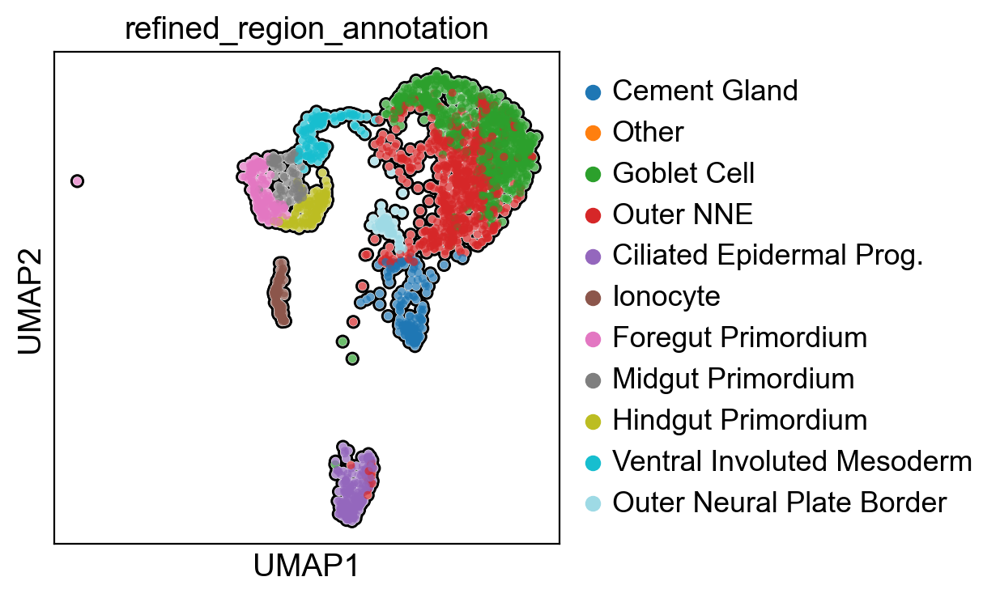

In [776]:
import scanpy as sc
import numpy as np
import pandas as pd

# 1. Calculate nearest neighbors (KNN graph) - Don't change UMAP positions, only labels
sc.pp.neighbors(outerecto_subset, n_neighbors=20, use_rep='X_pca')  # Adjust n_neighbors if needed

# 2. Get the original cluster labels
original_labels = outerecto_subset.obs['region_annotation'].copy()

# 3. Initialize new_labels with original ones
new_labels = original_labels.copy()

# 4. Access the KNN connectivities graph
connectivities = outerecto_subset.obsp['connectivities']

# 5. Loop through all cells and update their labels based on the majority of their neighbors
for i, cell in enumerate(outerecto_subset.obs.index):
    neighbor_indices = connectivities[i].indices
    neighbor_labels = original_labels.iloc[neighbor_indices]
    
    # Assign the most common label among neighbors
    if not neighbor_labels.empty:
        most_common_label = neighbor_labels.mode()[0]
        new_labels.iloc[i] = most_common_label

# 6. Save the smoothed labels to the object
outerecto_subset.obs['refined_region_annotation'] = new_labels

# 7. Visualize the smoothed labels
sc.pl.umap(outerecto_subset, color='refined_region_annotation', add_outline=True, palette="tab20")


In [405]:
sc.tl.leiden(outerecto_subset, key_added = "leiden_1.0") # default resolution in 1.0
sc.tl.leiden(outerecto_subset, resolution = 1.0, key_added = "leiden_1.0")

running Leiden clustering
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)


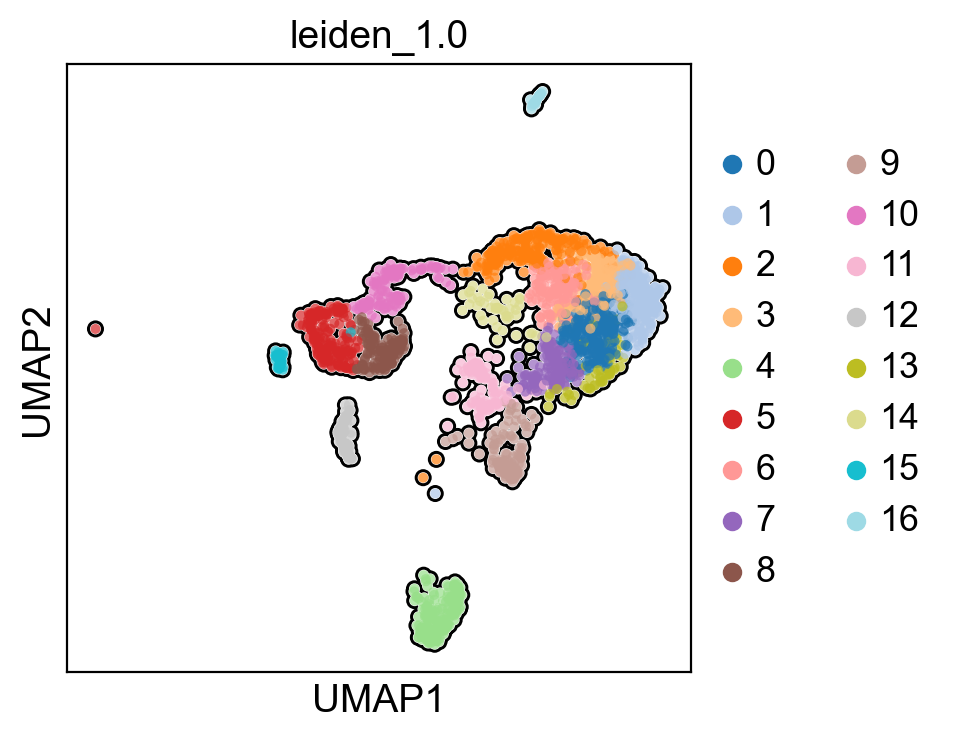

In [406]:
sc.pl.umap(outerecto_subset, color='leiden_1.0', add_outline=True, palette="tab20")


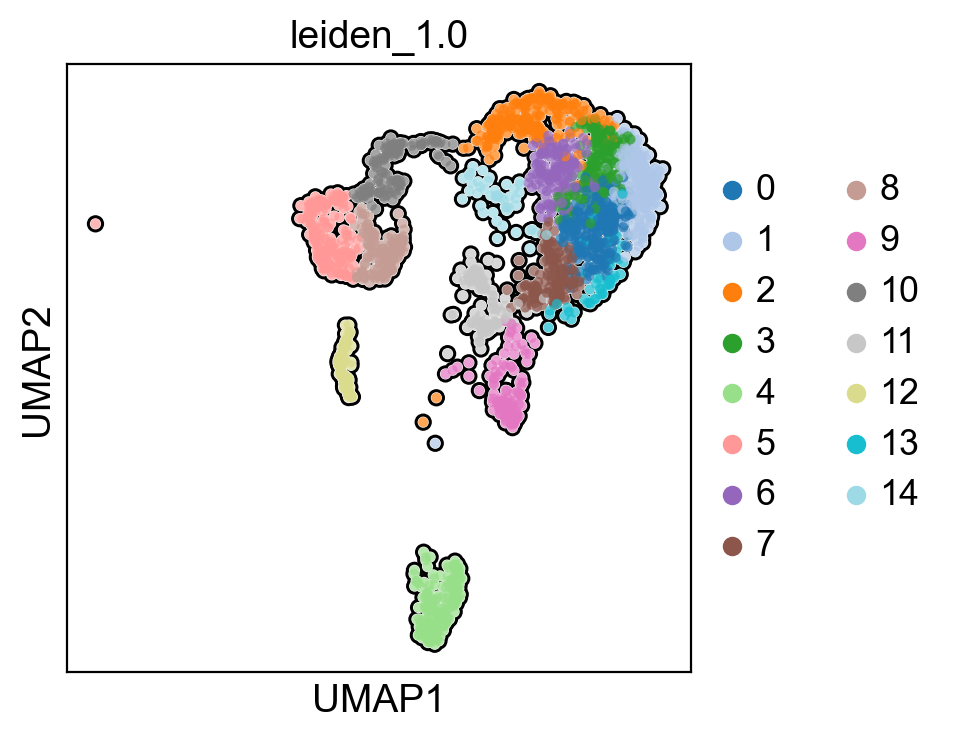

In [425]:
sc.tl.rank_genes_groups(outerecto_subset, groupby='leiden_1.0', n_genes=100, method='t-test')  # or whatever method you used
sc.pl.rank_genes_groups(outerecto_subset, n_genes=20, sharey=False)

# Filter out clusters '15' and '16' from the dataset
clusters_to_remove = ['15', '16']
outerecto_subset = outerecto_subset[~outerecto_subset.obs['leiden_1.0'].isin(clusters_to_remove)].copy()

# Optional: visualize UMAP again after filtering
sc.pl.umap(outerecto_subset, color='leiden_1.0', add_outline=True, palette="tab20")


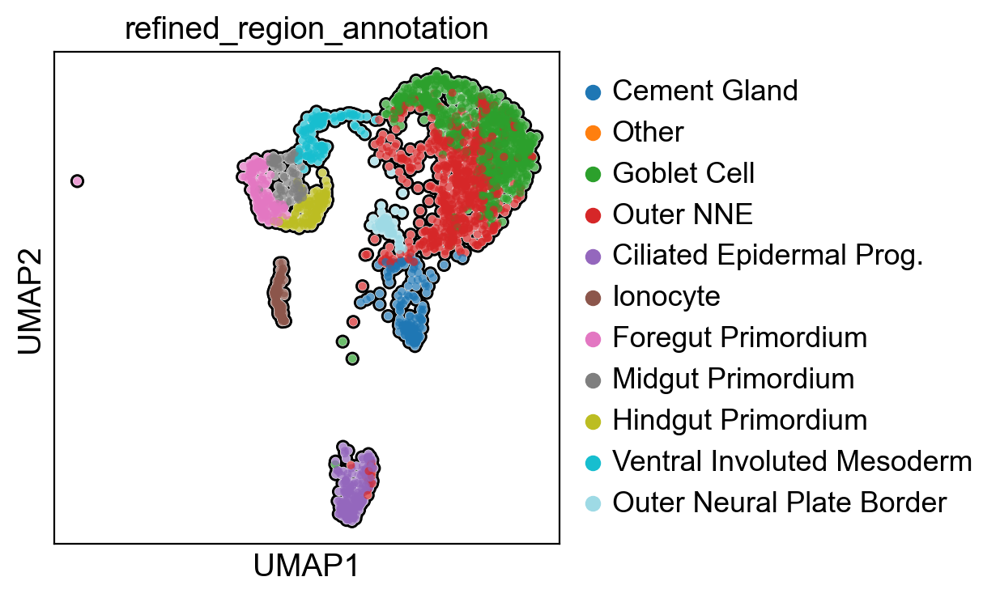

In [777]:
# Optional: visualize UMAP again after filtering
sc.pl.umap(outerecto_subset, color='refined_region_annotation', add_outline=True, palette="tab20")


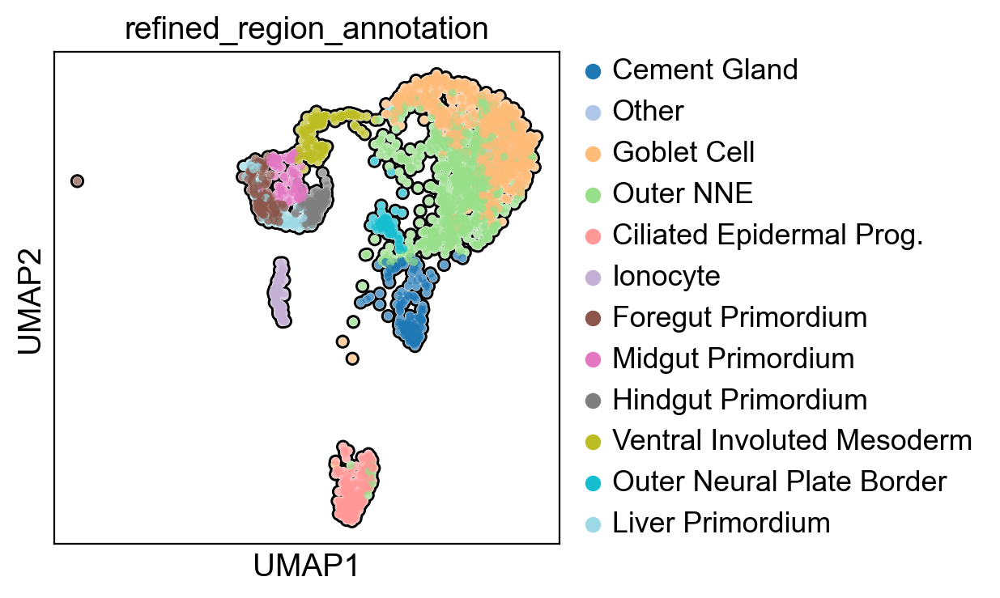

In [778]:
# Define expression threshold for HHEX
threshold_hhex = 1  # Adjust if needed

# Add the new category "Liver Primordium"
outerecto_subset.obs['refined_region_annotation'] = outerecto_subset.obs['refined_region_annotation'].cat.add_categories(['Liver Primordium'])

# Create expression mask for HHEX
hhex_mask = (outerecto_subset[:, 'hhex'].X > threshold_hhex).toarray().flatten()

# Apply the new label
outerecto_subset.obs.loc[hhex_mask, 'refined_region_annotation'] = 'Liver Primordium'

# Visualize updated annotations
sc.pl.umap(outerecto_subset, color='refined_region_annotation', add_outline=True, palette="tab20")


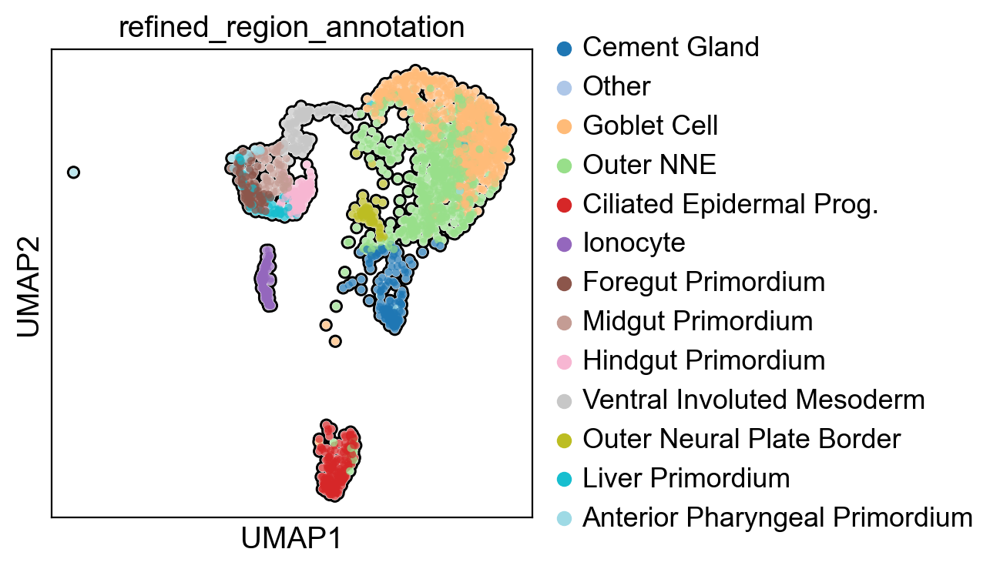

In [779]:
# Define expression threshold for GSC
threshold_gsc = 1  # Adjust if needed

# Add the new category "Anterior Pharyngeal Primordium"
outerecto_subset.obs['refined_region_annotation'] = outerecto_subset.obs['refined_region_annotation'].cat.add_categories(['Anterior Pharyngeal Primordium'])

# Create expression mask for GSC
gsc_mask = (outerecto_subset[:, 'gsc'].X > threshold_gsc).toarray().flatten()

# Apply the new label
outerecto_subset.obs.loc[gsc_mask, 'refined_region_annotation'] = 'Anterior Pharyngeal Primordium'

# Visualize updated annotations
sc.pl.umap(outerecto_subset, color='refined_region_annotation', add_outline=True, palette="tab20")


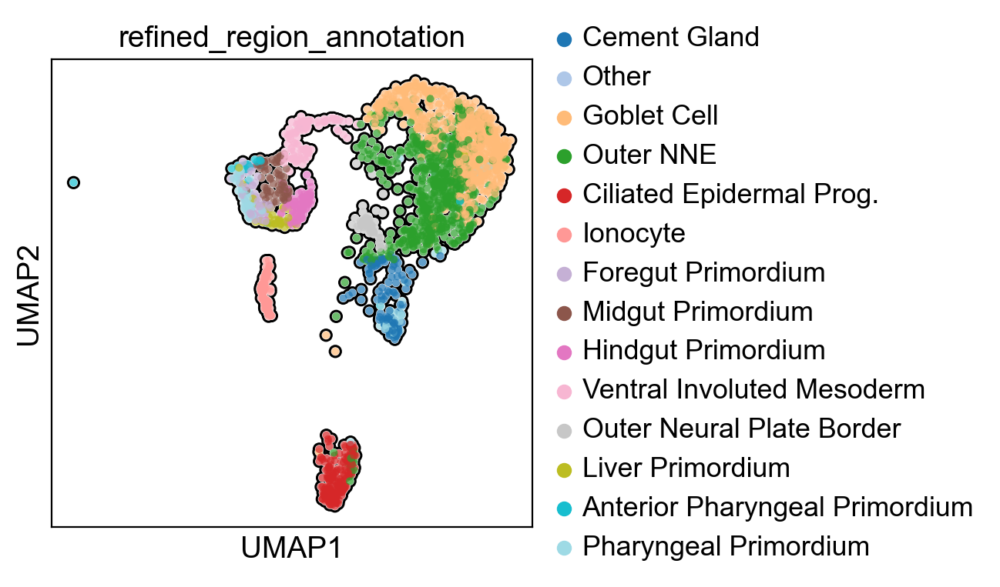

In [780]:
# Define expression threshold for NKX2-6
threshold_nkx26 = 1  # Adjust as needed

# Add the new category "Pharyngeal Primordium"
outerecto_subset.obs['refined_region_annotation'] = outerecto_subset.obs['refined_region_annotation'].cat.add_categories(['Pharyngeal Primordium'])

# Create expression mask for NKX2-6
nkx26_mask = (outerecto_subset[:, 'nkx2-6'].X > threshold_nkx26).toarray().flatten()

# Apply the new label
outerecto_subset.obs.loc[nkx26_mask, 'refined_region_annotation'] = 'Pharyngeal Primordium'

# Visualize the updated annotations
sc.pl.umap(outerecto_subset, color='refined_region_annotation', add_outline=True, palette="tab20")


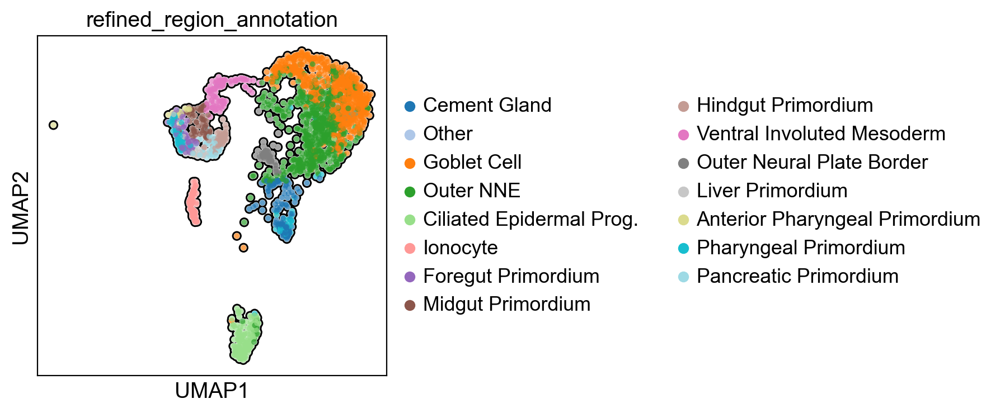

In [781]:
# Define expression threshold for PDX1
threshold_pdx1 = .5  # Adjust as needed

# Add the new category "Pancreatic Primordium"
outerecto_subset.obs['refined_region_annotation'] = outerecto_subset.obs['refined_region_annotation'].cat.add_categories(['Pancreatic Primordium'])

# Create expression mask for PDX1
pdx1_mask = (outerecto_subset[:, 'pdx1'].X > threshold_pdx1).toarray().flatten()

# Apply the new label
outerecto_subset.obs.loc[pdx1_mask, 'refined_region_annotation'] = 'Pancreatic Primordium'

# Visualize the result
sc.pl.umap(outerecto_subset, color='refined_region_annotation', add_outline=True, palette="tab20")


computing neighbors
    finished (0:00:00)


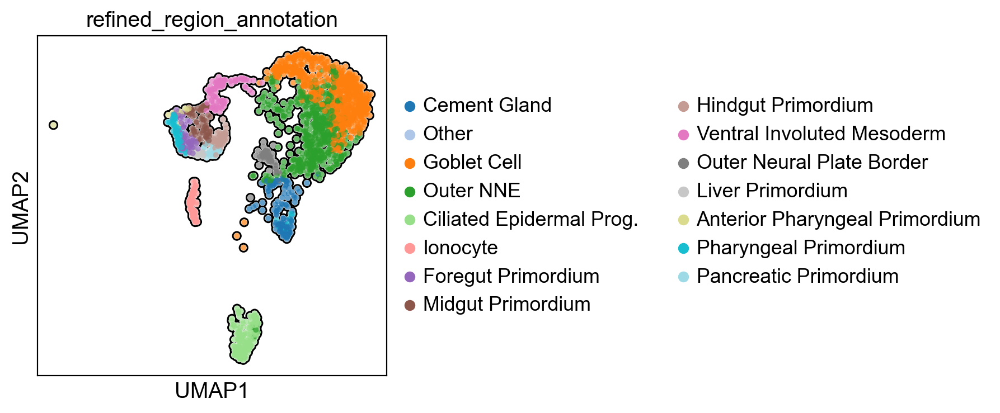

In [523]:
import scanpy as sc
import numpy as np
import pandas as pd

# 1. Calculate nearest neighbors (KNN graph) - Don't change UMAP positions, only labels
sc.pp.neighbors(outerecto_subset, n_neighbors=5, use_rep='X_pca')  # Adjust n_neighbors if needed

# 2. Get the original cluster labels
original_labels = outerecto_subset.obs['refined_region_annotation'].copy()

# 3. Initialize new_labels with original ones
new_labels = original_labels.copy()

# 4. Access the KNN connectivities graph
connectivities = outerecto_subset.obsp['connectivities']

# 5. Loop through all cells and update their labels based on the majority of their neighbors
for i, cell in enumerate(outerecto_subset.obs.index):
    neighbor_indices = connectivities[i].indices
    neighbor_labels = original_labels.iloc[neighbor_indices]
    
    # Assign the most common label among neighbors
    if not neighbor_labels.empty:
        most_common_label = neighbor_labels.mode()[0]
        new_labels.iloc[i] = most_common_label

# 6. Save the smoothed labels to the object
outerecto_subset.obs['refined_region_annotation'] = new_labels

# 7. Visualize the smoothed labels
sc.pl.umap(outerecto_subset, color='refined_region_annotation', add_outline=True, palette="tab20")


computing neighbors
    finished (0:00:00)


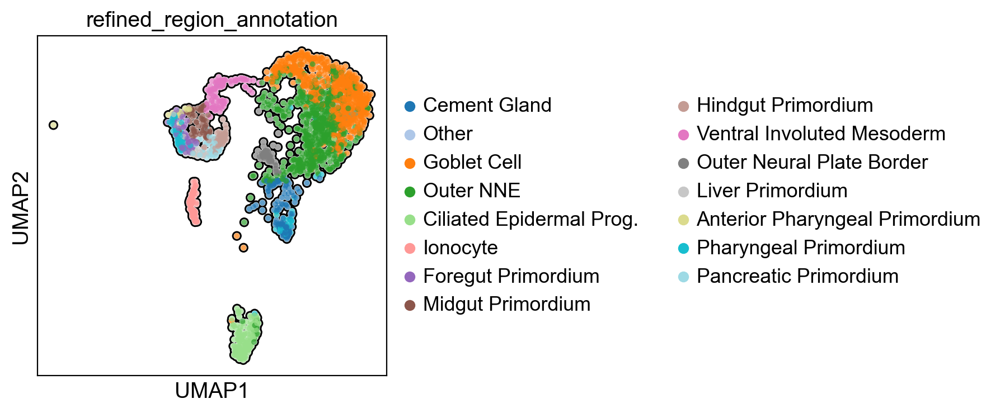

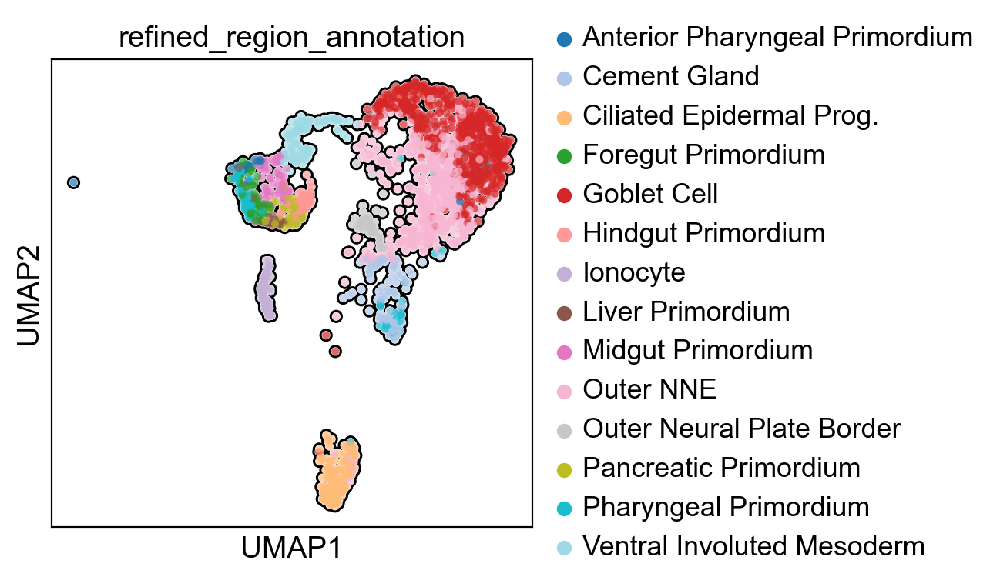

In [782]:
import scanpy as sc
import numpy as np

# 1. Compute neighbors
sc.pp.neighbors(outerecto_subset, n_neighbors=5, use_rep='X_pca')

# 2. Backup original annotations
original_labels = outerecto_subset.obs['refined_region_annotation'].copy()
new_labels = original_labels.copy()

# 3. Access connectivities
connectivities = outerecto_subset.obsp['connectivities']

# 4. Loop through cells and only update if the label is "Other"
for i, cell in enumerate(outerecto_subset.obs.index):
    if original_labels.iloc[i] == "Other":
        neighbor_indices = connectivities[i].indices
        neighbor_labels = original_labels.iloc[neighbor_indices]
        
        # Exclude "Other" from neighbor labels
        neighbor_labels = neighbor_labels[neighbor_labels != "Other"]
        if not neighbor_labels.empty:
            most_common_label = neighbor_labels.mode()[0]
            new_labels.iloc[i] = most_common_label

# 5. Assign new smoothed labels (only for 'Other' cells)
outerecto_subset.obs['refined_region_annotation'] = new_labels

# 6. Visualize
sc.pl.umap(outerecto_subset, color='refined_region_annotation', add_outline=True, palette="tab20")

# 7. Remove "Other" from the categories if still present
outerecto_subset.obs['refined_region_annotation'] = outerecto_subset.obs['refined_region_annotation'].cat.remove_categories(['Other'])

# Optional: Confirm update with another plot
sc.pl.umap(outerecto_subset, color='refined_region_annotation', add_outline=True, palette="tab20")


computing neighbors
    finished (0:00:00)


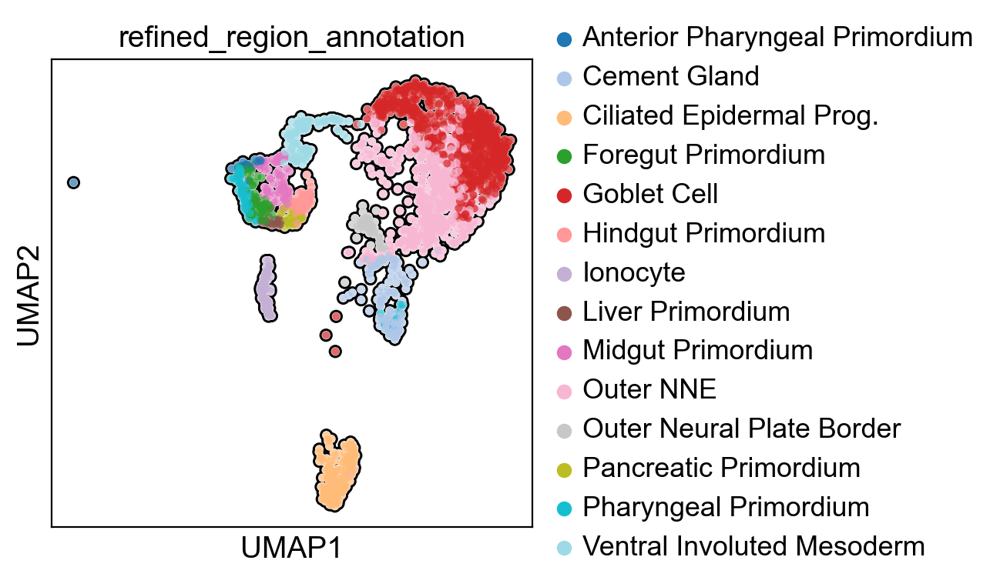

In [783]:
import scanpy as sc
import numpy as np
import pandas as pd

# 1. Calculate nearest neighbors (KNN graph) - Don't change UMAP positions, only labels
sc.pp.neighbors(outerecto_subset, n_neighbors=5, use_rep='X_pca')  # Adjust n_neighbors if needed

# 2. Get the original cluster labels
original_labels = outerecto_subset.obs['refined_region_annotation'].copy()

# 3. Initialize new_labels with original ones
new_labels = original_labels.copy()

# 4. Access the KNN connectivities graph
connectivities = outerecto_subset.obsp['connectivities']

# 5. Loop through all cells and update their labels based on the majority of their neighbors
for i, cell in enumerate(outerecto_subset.obs.index):
    neighbor_indices = connectivities[i].indices
    neighbor_labels = original_labels.iloc[neighbor_indices]
    
    # Assign the most common label among neighbors
    if not neighbor_labels.empty:
        most_common_label = neighbor_labels.mode()[0]
        new_labels.iloc[i] = most_common_label

# 6. Save the smoothed labels to the object
outerecto_subset.obs['refined_region_annotation'] = new_labels

# 7. Visualize the smoothed labels
sc.pl.umap(outerecto_subset, color='refined_region_annotation', add_outline=True, palette="tab20")


### Mesoderm (some figures omitted for space) ###

In [2]:
# Define the cluster labels you want to keep
selected_clusters = ['5', '6', '1', '12']

# Subset the AnnData object based on the leiden_0.1 column
meso_subset = corr_data[corr_data.obs['leiden_0.3'].isin(selected_clusters)].copy()
sc.pl.umap(meso_subset, color = "leiden_0.3", add_outline=True, palette="tab20")

NameError: name 'corr_data' is not defined

In [3]:
sc.tl.leiden(meso_subset, key_added = "leiden_1.0") # default resolution in 1.0
sc.tl.leiden(meso_subset, resolution = 1.0, key_added = "leiden_1.0")

NameError: name 'meso_subset' is not defined

In [4]:
sc.pl.umap(meso_subset, color = "leiden_0.8", add_outline=True, palette="tab20")

NameError: name 'meso_subset' is not defined

In [5]:
# Define a threshold for "high" expression
threshold = .5  # adjust based on your data (you might use 0.5, 1, or a quantile)

# Logical mask: cells where both rax and pax6 are highly expressed
mask = (meso_subset[:, 'pax8'].X > threshold).toarray().flatten() & \
       (meso_subset[:, 'lhx1'].X > threshold).toarray().flatten()

# Create a new column for annotation if it doesn't exist
meso_subset.obs['region_annotation'] = 'Other'

# Assign "Anterior Neural Plate" to cells meeting the condition
meso_subset.obs.loc[mask, 'region_annotation'] = 'Pronephric Primordium'
sc.pl.umap(meso_subset, color = "region_annotation", add_outline=True, palette="tab20")

NameError: name 'meso_subset' is not defined

In [6]:
# Define expression thresholds
threshold_ank1 = 0.25
threshold_actc1 = 0.25  # Adjust as needed

# Add the new category if not already present
meso_subset.obs['region_annotation'] = meso_subset.obs['region_annotation'].cat.add_categories(['Anterior Paraxial Mesoderm'])

# Create expression masks
ank1_mask = (meso_subset[:, 'ank1'].X > threshold_ank1).toarray().flatten()
actc1_mask = (meso_subset[:, 'actc1'].X > threshold_actc1).toarray().flatten()

# Combine both masks (AND logic)
anterior_para_mask = ank1_mask & actc1_mask

# Apply the label
meso_subset.obs.loc[anterior_para_mask, 'region_annotation'] = 'Anterior Paraxial Mesoderm'

# Visualize updated annotations
sc.pl.umap(meso_subset, color='region_annotation', add_outline=True, palette="tab20")


NameError: name 'meso_subset' is not defined

In [7]:
# Define expression thresholds
threshold_myf5 = 1
threshold_hoxd3 = 1  # Adjust if needed

# Add the new category
meso_subset.obs['region_annotation'] = meso_subset.obs['region_annotation'].cat.add_categories(['Posterior Paraxial Mesoderm'])

# Create expression masks
myf5_mask = (meso_subset[:, 'myf5'].X > threshold_myf5).toarray().flatten()
hoxd3_mask = (meso_subset[:, 'hoxd3'].X > threshold_hoxd3).toarray().flatten()

# Combine masks (AND logic)
posterior_para_mask = myf5_mask & hoxd3_mask

# Apply the new label
meso_subset.obs.loc[posterior_para_mask, 'region_annotation'] = 'Posterior Paraxial Mesoderm'

# Visualize the result
sc.pl.umap(meso_subset, color='region_annotation', add_outline=True, palette="tab20")


NameError: name 'meso_subset' is not defined

In [8]:
# Define expression threshold for TBX1
threshold_tbx1 = 1  # Adjust as needed

# Add the new category "Pharyngeal Mesoderm"
meso_subset.obs['region_annotation'] = meso_subset.obs['region_annotation'].cat.add_categories(['Pharyngeal Mesoderm'])

# Create expression mask
tbx1_mask = (meso_subset[:, 'tbx1'].X > threshold_tbx1).toarray().flatten()

# Apply the label
meso_subset.obs.loc[tbx1_mask, 'region_annotation'] = 'Pharyngeal Mesoderm'

# Visualize the result
sc.pl.umap(meso_subset, color='region_annotation', add_outline=True, palette="tab20")


NameError: name 'meso_subset' is not defined

In [9]:
# Define expression threshold for NKX2-5
threshold_nkx25 = 1  # Adjust as needed

# Add the new category "Cardiac Mesoderm"
meso_subset.obs['region_annotation'] = meso_subset.obs['region_annotation'].cat.add_categories(['Cardiac Mesoderm'])

# Create expression mask
nkx25_mask = (meso_subset[:, 'nkx2-5'].X > threshold_nkx25).toarray().flatten()

# Apply the label
meso_subset.obs.loc[nkx25_mask, 'region_annotation'] = 'Cardiac Mesoderm'

# Visualize the updated annotation
sc.pl.umap(meso_subset, color='region_annotation', add_outline=True, palette="tab20")


NameError: name 'meso_subset' is not defined

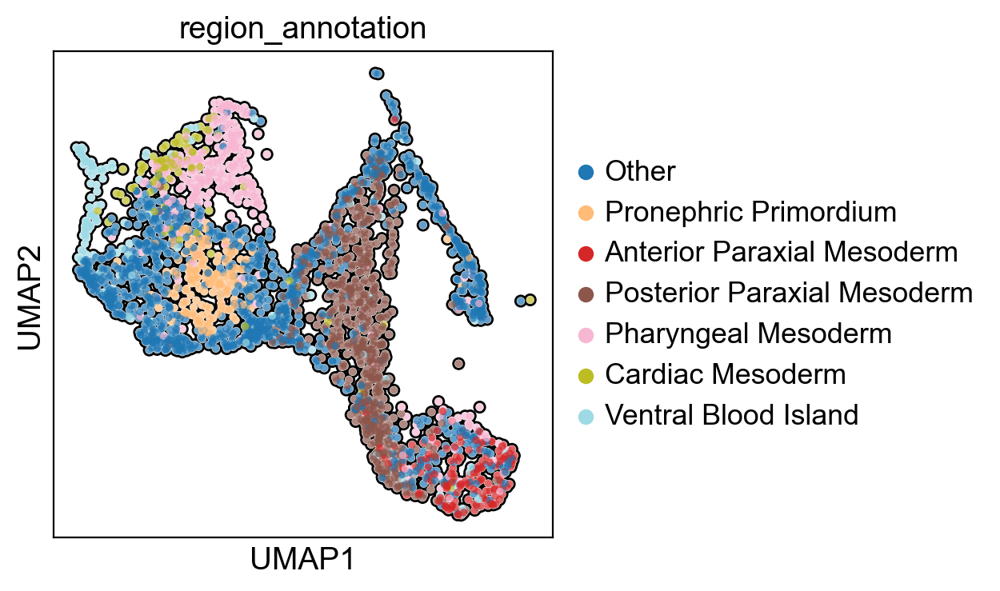

In [702]:
# Define expression threshold for RUNX1
threshold_runx1 = 1  # Adjust as needed

# Add the new category "Ventral Blood Island"
meso_subset.obs['region_annotation'] = meso_subset.obs['region_annotation'].cat.add_categories(['Ventral Blood Island'])

# Create expression mask
runx1_mask = (meso_subset[:, 'runx1'].X > threshold_runx1).toarray().flatten()

# Apply the new label
meso_subset.obs.loc[runx1_mask, 'region_annotation'] = 'Ventral Blood Island'

# Visualize the updated annotation
sc.pl.umap(meso_subset, color='region_annotation', add_outline=True, palette="tab20")


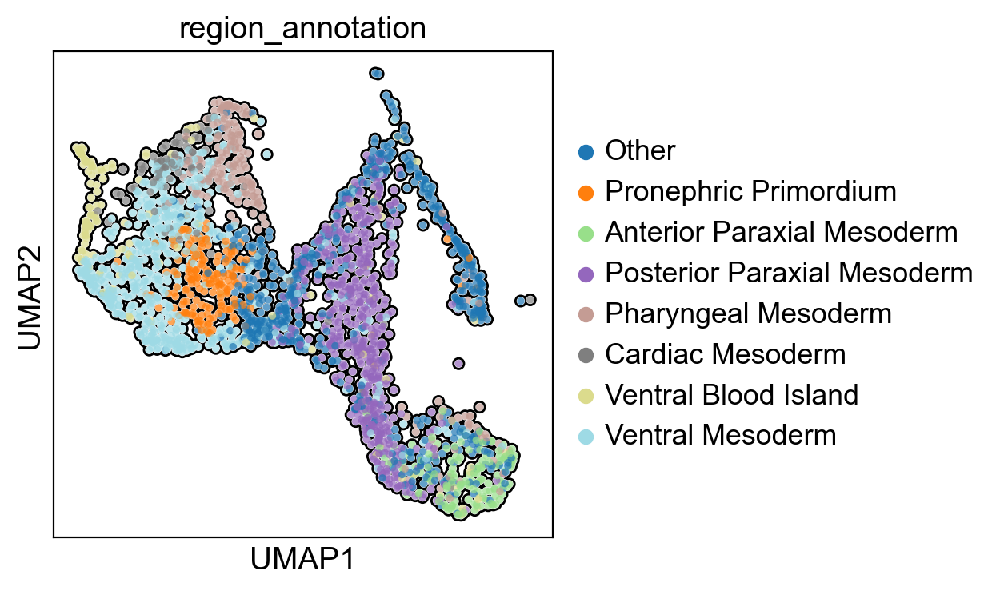

In [703]:
# Define expression threshold for GATA6
threshold_gata4 = 1  # Adjust as needed

# Add the new category "Ventral Mesoderm"
meso_subset.obs['region_annotation'] = meso_subset.obs['region_annotation'].cat.add_categories(['Ventral Mesoderm'])

# Create expression mask using GATA6
gata4_mask = (meso_subset[:, 'gata6'].X > threshold_gata4).toarray().flatten()

# Mask to exclude cells already labeled as:
protected_labels = ['Ventral Blood Island', 'Pronephric Primordium', 'Cardiac Mesoderm']
not_protected = ~meso_subset.obs['region_annotation'].isin(protected_labels)

# Final mask: high gata6 expression AND not in protected labels
ventral_mesoderm_mask = gata4_mask & not_protected

# Apply the new label
meso_subset.obs.loc[ventral_mesoderm_mask, 'region_annotation'] = 'Ventral Mesoderm'

# Visualize the updated annotations
sc.pl.umap(meso_subset, color='region_annotation', add_outline=True, palette="tab20")


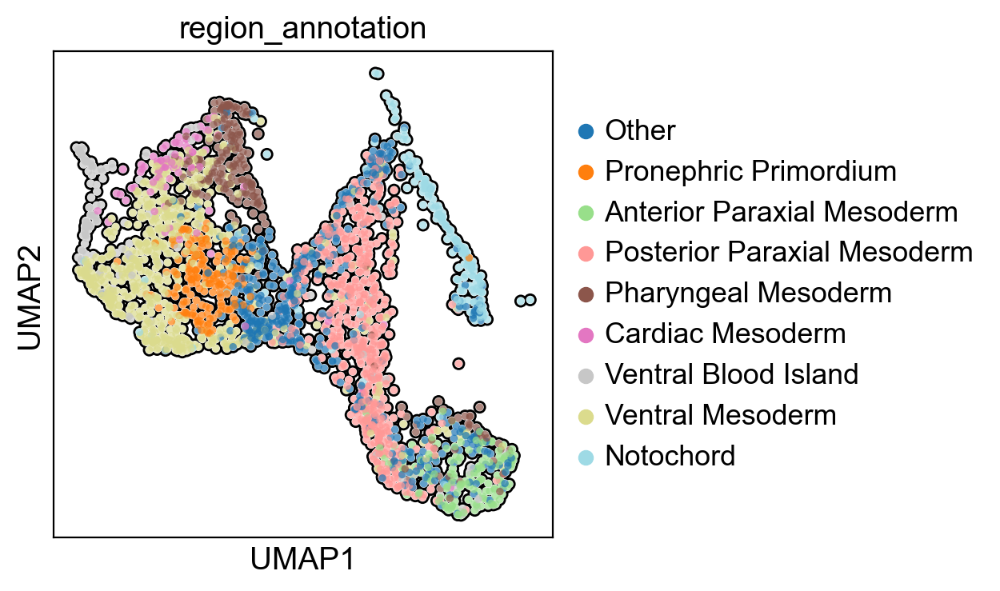

In [704]:
# Define expression threshold for CHRD
threshold_chrd = 1  # Adjust if needed

# Add the new category "Notochord"
meso_subset.obs['region_annotation'] = meso_subset.obs['region_annotation'].cat.add_categories(['Notochord'])

# Create expression mask
chrd_mask = (meso_subset[:, 'not'].X > threshold_chrd).toarray().flatten()

# Apply the label
meso_subset.obs.loc[chrd_mask, 'region_annotation'] = 'Notochord'

# Visualize
sc.pl.umap(meso_subset, color='region_annotation', add_outline=True, palette="tab20")


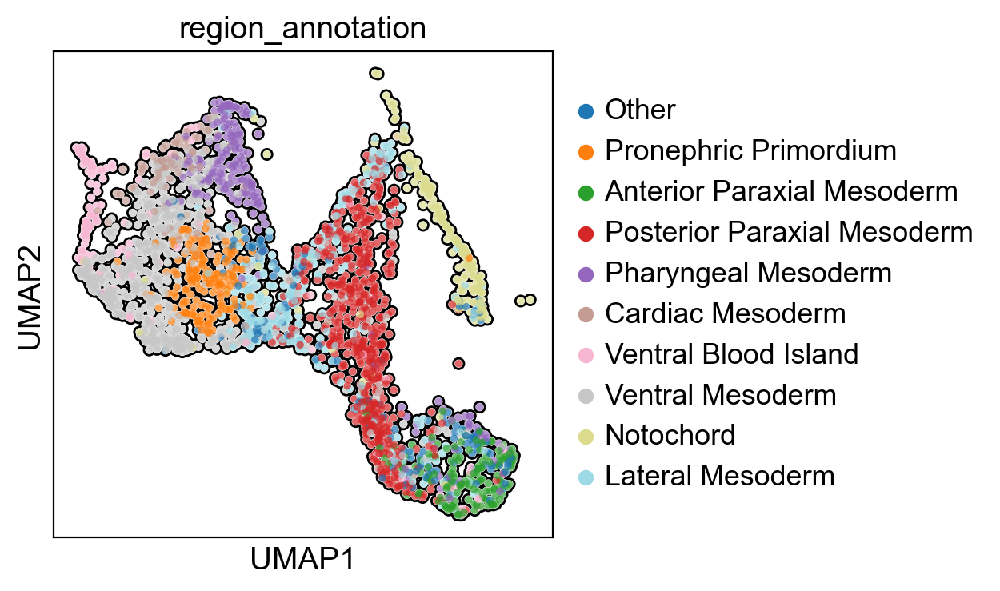

In [705]:
# Define expression thresholds
threshold_foxc1 = 0.1
threshold_tbxt = 1  # Adjust as needed

# Add the new category "Lateral Mesoderm" if not already present
meso_subset.obs['region_annotation'] = meso_subset.obs['region_annotation'].cat.add_categories(['Lateral Mesoderm'])

# Create expression masks for FOXC1 and TBXT
foxc1_mask = (meso_subset[:, 'foxc1'].X > threshold_foxc1).toarray().flatten()
tbxt_mask = (meso_subset[:, 'tbxt'].X > threshold_tbxt).toarray().flatten()

# Combine masks with OR logic
combined_mask = foxc1_mask | tbxt_mask

# Only allow overwrite if current label is "Other"
only_other = meso_subset.obs['region_annotation'] == 'Other'

# Final mask: (foxc1 or tbxt) AND currently labeled as "Other"
lateral_mesoderm_mask = combined_mask & only_other

# Apply the new label
meso_subset.obs.loc[lateral_mesoderm_mask, 'region_annotation'] = 'Lateral Mesoderm'

# Visualize
sc.pl.umap(meso_subset, color='region_annotation', add_outline=True, palette="tab20")


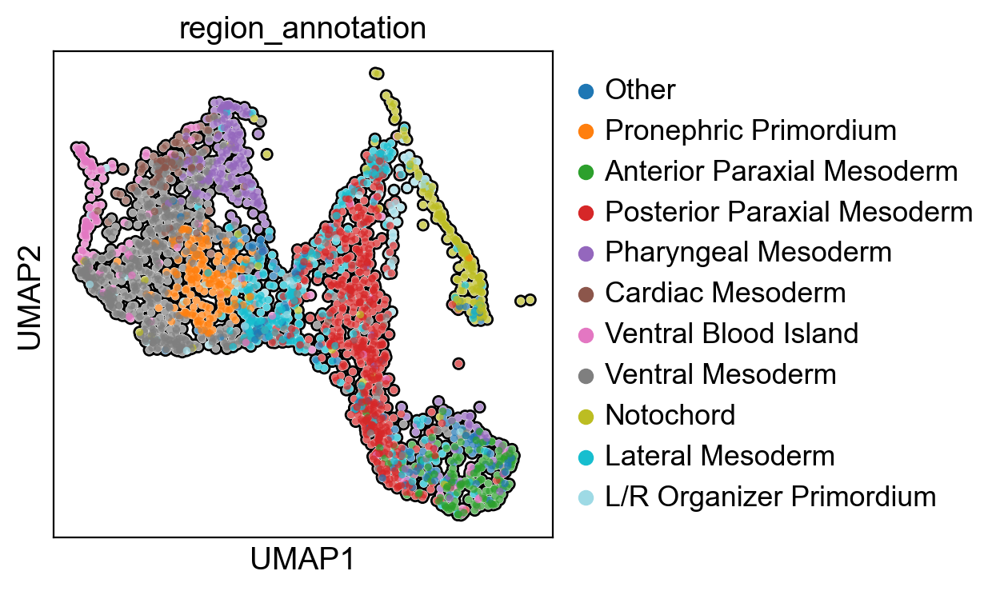

In [733]:
# Define expression threshold for CIROP
threshold_cirop = 1  # Adjust as needed

# Add the new category "L/R Organizer Primordium" if not already present
meso_subset.obs['region_annotation'] = meso_subset.obs['region_annotation'].cat.add_categories(['L/R Organizer Primordium'])

# Create expression mask for CIROP
cirop_mask = (meso_subset[:, 'cirop'].X > threshold_cirop).toarray().flatten()

# Apply the new label directly (overwrite any current label)
meso_subset.obs.loc[cirop_mask, 'region_annotation'] = 'L/R Organizer Primordium'

# Visualize
sc.pl.umap(meso_subset, color='region_annotation', add_outline=True, palette="tab20")


computing neighbors
    finished (0:00:00)


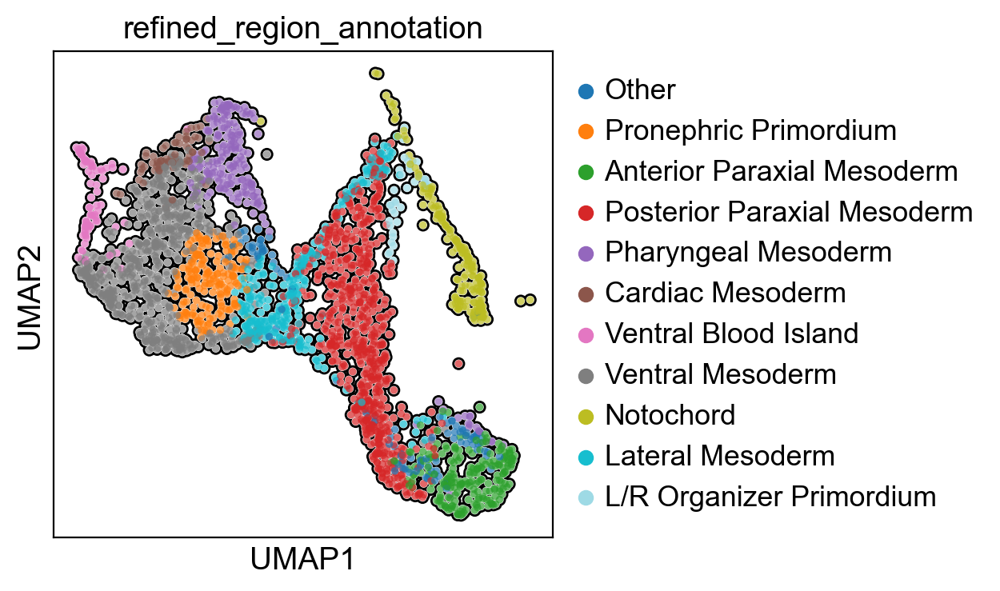

In [734]:
import scanpy as sc
import numpy as np
import pandas as pd

# 1. Calculate nearest neighbors (KNN graph)
sc.pp.neighbors(meso_subset, n_neighbors=10, use_rep='X_pca')  # You can tweak n_neighbors if needed

# 2. Backup original region annotations
original_labels = meso_subset.obs['region_annotation'].copy()

# 3. Initialize new labels with original ones
new_labels = original_labels.copy()

# 4. Access the connectivities matrix
connectivities = meso_subset.obsp['connectivities']

# 5. Loop through each cell and assign majority label of its neighbors
for i, cell in enumerate(meso_subset.obs.index):
    neighbor_indices = connectivities[i].indices
    neighbor_labels = original_labels.iloc[neighbor_indices]

    if not neighbor_labels.empty:
        most_common_label = neighbor_labels.mode()[0]
        new_labels.iloc[i] = most_common_label

# 6. Assign the new smoothed labels to the dataset
meso_subset.obs['refined_region_annotation'] = new_labels

# 7. Visualize the updated labels
sc.pl.umap(meso_subset, color='refined_region_annotation', add_outline=True, palette="tab20")


computing neighbors
    finished (0:00:00)


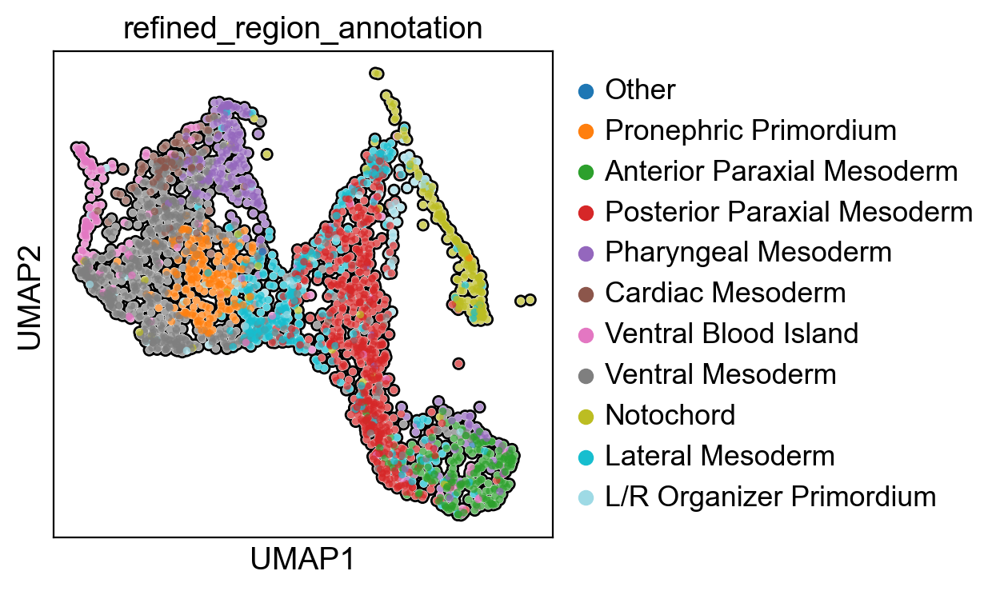

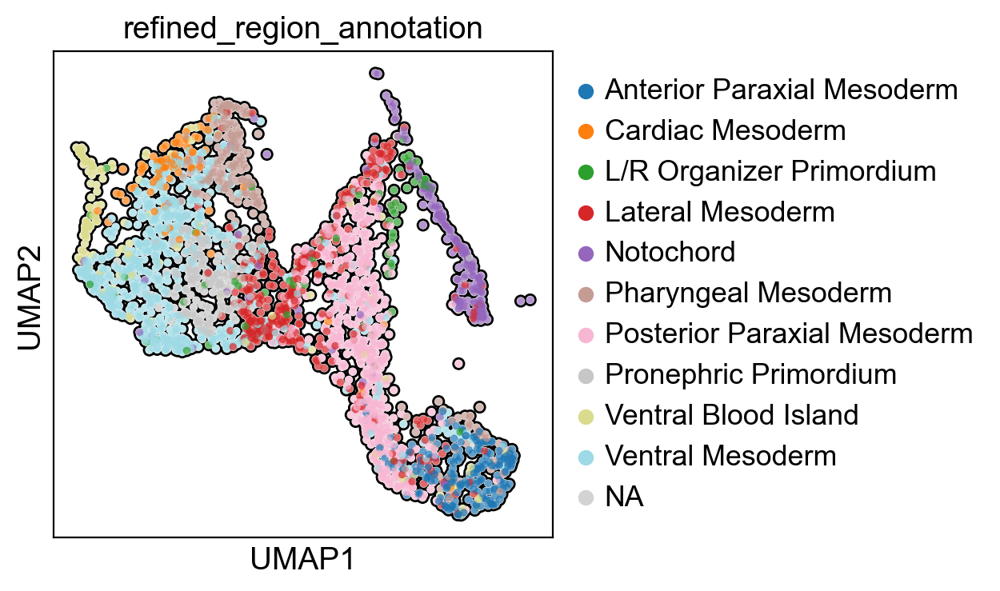

In [735]:
import scanpy as sc
import numpy as np
import pandas as pd

# 1. Compute neighbors
sc.pp.neighbors(meso_subset, n_neighbors=5, use_rep='X_pca')

# 2. Backup original annotations
original_labels = meso_subset.obs['region_annotation'].copy()
new_labels = original_labels.copy()

# 3. Access connectivities
connectivities = meso_subset.obsp['connectivities']

# 4. Loop through cells and only update if the label is "Other"
for i, cell in enumerate(meso_subset.obs.index):
    if original_labels.iloc[i] == "Other":
        neighbor_indices = connectivities[i].indices
        neighbor_labels = original_labels.iloc[neighbor_indices]
        
        # Get the most common label among neighbors (excluding "Other")
        neighbor_labels = neighbor_labels[neighbor_labels != "Other"]
        if not neighbor_labels.empty:
            most_common_label = neighbor_labels.mode()[0]
            new_labels.iloc[i] = most_common_label

# 5. Assign new smoothed labels (only for 'Other' cells)
meso_subset.obs['refined_region_annotation'] = new_labels

# 6. Visualize
sc.pl.umap(meso_subset, color='refined_region_annotation', add_outline=True, palette="tab20")

# Remove "Other" from the categories (if still present)
meso_subset.obs['refined_region_annotation'] = meso_subset.obs['refined_region_annotation'].cat.remove_categories(['Other'])

# Optional: Visualize to confirm
sc.pl.umap(meso_subset, color='refined_region_annotation', add_outline=True, palette="tab20")



computing neighbors
    finished (0:00:00)


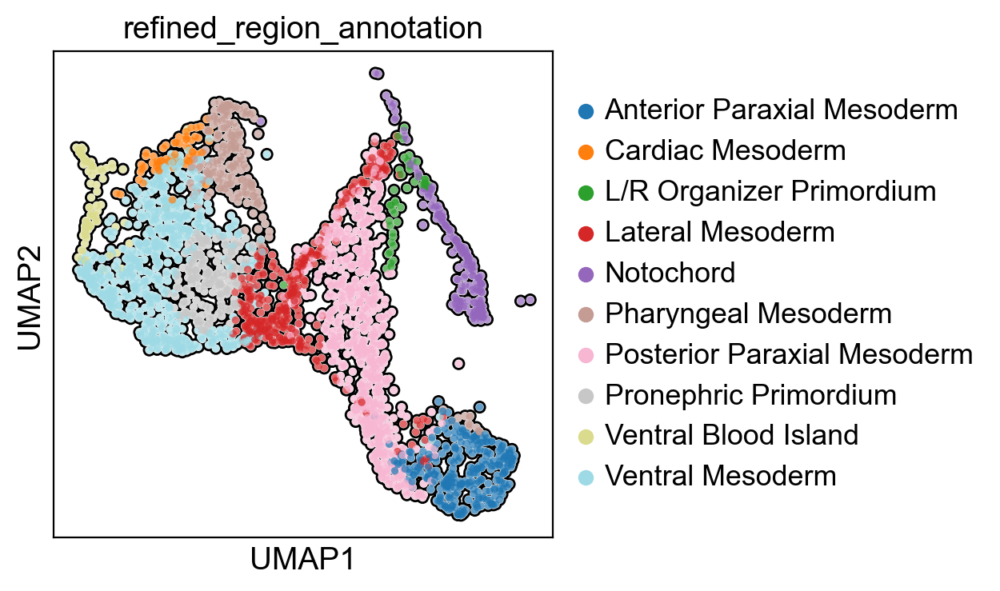

In [736]:
import scanpy as sc
import numpy as np
import pandas as pd

# 1. Calculate nearest neighbors (KNN graph)
sc.pp.neighbors(meso_subset, n_neighbors=10, use_rep='X_pca')  # You can tweak n_neighbors if needed

# 2. Backup original region annotations
original_labels = meso_subset.obs['refined_region_annotation'].copy()

# 3. Initialize new labels with original ones
new_labels = original_labels.copy()

# 4. Access the connectivities matrix
connectivities = meso_subset.obsp['connectivities']

# 5. Loop through each cell and assign majority label of its neighbors
for i, cell in enumerate(meso_subset.obs.index):
    neighbor_indices = connectivities[i].indices
    neighbor_labels = original_labels.iloc[neighbor_indices]

    if not neighbor_labels.empty:
        most_common_label = neighbor_labels.mode()[0]
        new_labels.iloc[i] = most_common_label

# 6. Assign the new smoothed labels to the dataset
meso_subset.obs['refined_region_annotation'] = new_labels

# 7. Visualize the updated labels
sc.pl.umap(meso_subset, color='refined_region_annotation', add_outline=True, palette="tab20")


### Combining Annotations ###

In [800]:
import scanpy as sc

# Ensure corr_data is an AnnData object (if it's a pandas DataFrame, you can convert it to AnnData)
# If corr_data is already an AnnData object, you can skip this step.
# corr_data = sc.AnnData(corr_data)

# 1. Copy labels from meso_subset to corr_data
if 'refined_region_annotation' in meso_subset.obs.columns:
    corr_data.obs['region_annotation_meso'] = meso_subset.obs['refined_region_annotation'].copy()

# 2. Copy labels from outerecto_subset to corr_data
if 'refined_region_annotation' in outerecto_subset.obs.columns:
    corr_data.obs['region_annotation_outerecto'] = outerecto_subset.obs['refined_region_annotation'].copy()

# 3. Copy labels from innerecto_subset to corr_data
if 'refined_region_annotation' in innerecto_subset.obs.columns:
    corr_data.obs['region_annotation_innerecto'] = innerecto_subset.obs['refined_region_annotation'].copy()

# 4. Optionally, check that the labels are correctly copied
print(corr_data.obs.head())

              orig.ident  nCount_RNA  nFeature_RNA      bc_wells  \
07_01_10__s1           0     10898.0          3562  07_01_10__s1   
07_01_25__s1           0     10037.0          3522  07_01_25__s1   
07_01_30__s1           0     10297.0          3477  07_01_30__s1   
07_01_35__s1           0     19016.0          4240  07_01_35__s1   
07_01_46__s1           0     16496.0          3686  07_01_46__s1   

                                 sample   species  gene_count  tscp_count  \
07_01_10__s1  X__tropicalis_st13_NUCLEI  XENTR-10        3562       10898   
07_01_25__s1  X__tropicalis_st13_NUCLEI  XENTR-10        3522       10037   
07_01_30__s1  X__tropicalis_st13_NUCLEI  XENTR-10        3477       10297   
07_01_35__s1  X__tropicalis_st13_NUCLEI  XENTR-10        4240       19016   
07_01_46__s1  X__tropicalis_st13_NUCLEI  XENTR-10        3686       16496   

              mread_count  bc1_wind  ...  leiden_0.8  leiden_1.2 leiden_1.4  \
07_01_10__s1        22710         7  ...         

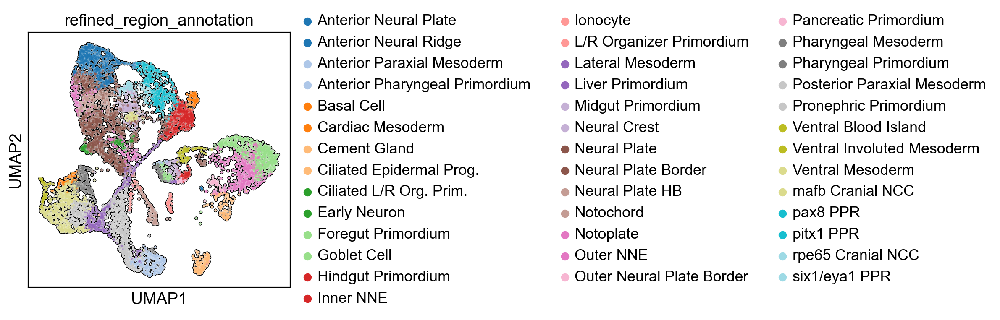

In [804]:
import scanpy as sc
import numpy as np
import pandas as pd

# Step 1: Initialize the final column with "Other"
corr_data.obs['refined_region_annotation'] = 'Other'

# Step 2: Fill in annotations from meso_subset
if 'region_annotation_meso' in corr_data.obs.columns:
    mask = ~corr_data.obs['region_annotation_meso'].isna()
    corr_data.obs.loc[mask, 'refined_region_annotation'] = corr_data.obs.loc[mask, 'region_annotation_meso']

# Step 3: Fill in annotations from outerecto_subset, overwriting if present
if 'region_annotation_outerecto' in corr_data.obs.columns:
    mask = ~corr_data.obs['region_annotation_outerecto'].isna()
    corr_data.obs.loc[mask, 'refined_region_annotation'] = corr_data.obs.loc[mask, 'region_annotation_outerecto']

# Step 4: Fill in annotations from innerecto_subset, overwriting if present
if 'region_annotation_innerecto' in corr_data.obs.columns:
    mask = ~corr_data.obs['region_annotation_innerecto'].isna()
    corr_data.obs.loc[mask, 'refined_region_annotation'] = corr_data.obs.loc[mask, 'region_annotation_innerecto']

# Step 5: Visualize the merged result
sc.pl.umap(corr_data, color='refined_region_annotation', add_outline=True, palette="tab20")


In [805]:
corr_data.write("Stage13_WT_Annotated.h5ad")


In [809]:
corr_data.var

,features,mt,ribo,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,highly_variable,means,dispersions,dispersions_norm
XBmRNA100499,XBmRNA100499,False,False,128,0.009501,98.729402,95.708608,True,0.025942,0.914678,0.249700
XBmRNA100003,XBmRNA100003,False,False,304,0.021969,96.982331,221.320386,True,0.060227,0.997856,0.493930
gsg1l,gsg1l,False,False,458,0.034190,95.453643,344.432726,True,0.088497,0.918886,0.262056
XBmRNA100502,XBmRNA100502,False,False,369,0.024498,96.337105,246.789396,True,0.065039,0.831364,0.005072
XBmRNA100423,XBmRNA100423,False,False,307,0.020161,96.952551,203.098475,True,0.056582,0.855454,0.075804
...,...,...,...,...,...,...,...,...,...,...,...
LOC116411071,LOC116411071,False,False,293,0.020346,97.091523,204.969198,True,0.054653,0.912468,0.243210
LOC116408464,LOC116408464,False,False,34,0.002598,99.662498,26.170087,True,0.007348,1.092466,0.771727
LOC116406610,LOC116406610,False,False,154,0.010356,98.471312,104.322916,True,0.029674,0.924848,0.279563
LOC116409744,LOC116409744,False,False,77,0.005419,99.235656,54.590964,True,0.014553,0.948162,0.348017


In [ ]:
corr_data.write("Stage13_WT_Annotated.h5ad")